In [1]:
import csv
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import ticker
from matplotlib.ticker import (AutoMinorLocator, MultipleLocator)

from scipy.stats import zscore
from sklearn.impute import KNNImputer
from scipy.spatial import distance
from scipy.interpolate import interp1d
from scipy import stats
from scipy.stats import chi2
from scipy.spatial.distance import mahalanobis

In [2]:
from pathlib import Path
print(Path.cwd())

from os import walk

# folder path
dir_path = r'C:\Users\Sang\OneDrive - Harvard University\CGBC\DataRelease\Sang_Code_Processing_2024\0. Raw data\Year 4Final\Desigo\Zone slab temperature'

file_list = []
for (dir_path, dir_names, file_names) in walk(dir_path):
    file_list.extend(file_names)
    # don't look inside any subdirectory
    break
print(file_list)

c:\Users\Sang\OneDrive - Harvard University\CGBC\DataRelease\Final_Processing_Code_2024\Code Year4
['HZ_Z11_slabtemp_060123-053124_raw.csv', 'HZ_Z12_slabtemp_060123-053124_raw.csv', 'HZ_Z13_slabtemp_060123-053124_raw.csv', 'HZ_Z14_slabtemp_060123-053124_raw.csv', 'HZ_Z15_slabtemp_060123-053124_raw.csv', 'HZ_Z16_slabtemp_060123-053124_raw.csv', 'HZ_Z17_slabtemp_060123-053124_raw.csv', 'HZ_Z1_slabtemp_060123-053124_raw.csv', 'HZ_Z21_slabtemp_060123-053124_raw.csv', 'HZ_Z22_slabtemp_060123-053124_raw.csv', 'HZ_Z23_slabtemp_060123-053124_raw.csv', 'HZ_Z24_slabtemp_060123-053124_raw.csv', 'HZ_Z25_slabtemp_060123-053124_raw.csv', 'HZ_Z26_slabtemp_060123-053124_raw.csv', 'HZ_Z27_slabtemp_060123-053124_raw.csv', 'HZ_Z2_slabtemp_060123-053124_raw.csv', 'HZ_Z31_slabtemp_060123-053124_raw.csv', 'HZ_Z32_slabtemp_060123-053124_raw.csv', 'HZ_Z33_slabtemp_060123-053124_raw.csv', 'HZ_Z4_slabtemp_060123-053124_raw.csv']


In [3]:
import os

Lst = []
for i in range(0, len(file_list)):
    # Construct the full path for each file
    file_path = os.path.join(dir_path, file_list[i])
    # Use the full path to read the CSV file
    data = pd.read_csv(file_path, parse_dates=['Timestamp'], index_col=[0])
    filtered_df = data[data['QualityGood'] == True]
    print(len(filtered_df))
    Lst.append(filtered_df)

527011
527011
527011
527010
527011
527011
527011
527012
527011
527011
527011
527010
527010
527010
527009
527012
527008
527008
527007
527012


In [4]:
Lst_Temp = []
Lst_name = []
Zone_Temp = pd.DataFrame()
res = 1

for i in range(0,len(Lst)):
    
    Lst[i].index = pd.to_datetime(Lst[i].index, errors='coerce', utc=True, format='mixed' )
    Lst[i].index = Lst[i].index.tz_convert('US/Eastern')
#     Lst[i].index = pd.to_datetime(Lst[i].index,format='mixed')
    Lst[i] = Lst[i].resample("1T").mean().ffill()
    
    zone_name = Lst[i].columns.values[0]
    Lst_name.append(zone_name)
    Z = pd.to_numeric(Lst[i][zone_name])
    Lst_Temp.append(Z.tolist())
    
    Zone_Temp[zone_name] = pd.Series(Z, index=Lst[i].index)
    
Zone_Temp

C:\Users\Sang\AppData\Local\Temp\ipykernel_6464\1368790191.py:11: FutureWarning: 'T' is deprecated and will be removed in a future version, please use 'min' instead.
  Lst[i] = Lst[i].resample("1T").mean().ffill()
C:\Users\Sang\AppData\Local\Temp\ipykernel_6464\1368790191.py:11: FutureWarning: 'T' is deprecated and will be removed in a future version, please use 'min' instead.
  Lst[i] = Lst[i].resample("1T").mean().ffill()
C:\Users\Sang\AppData\Local\Temp\ipykernel_6464\1368790191.py:11: FutureWarning: 'T' is deprecated and will be removed in a future version, please use 'min' instead.
  Lst[i] = Lst[i].resample("1T").mean().ffill()
C:\Users\Sang\AppData\Local\Temp\ipykernel_6464\1368790191.py:11: FutureWarning: 'T' is deprecated and will be removed in a future version, please use 'min' instead.
  Lst[i] = Lst[i].resample("1T").mean().ffill()
C:\Users\Sang\AppData\Local\Temp\ipykernel_6464\1368790191.py:11: FutureWarning: 'T' is deprecated and will be removed in a future version, plea

,Z11_temp,Z12_temp,Z13_temp,Z14_temp,Z15_temp,Z16_temp,Z17_temp,Z1_temp,Z21_temp,Z22_temp,Z23_temp,Z24_temp,Z25_temp,Z26_temp,Z27_temp,Z2_temp,Z31_temp,Z32_temp,Z33_temp,Z4_temp
Timestamp,,,,,,,,,,,,,,,,,,,,
2023-06-01 00:00:00-04:00,71.059998,71.599998,72.319992,72.319992,72.319992,71.599998,70.699997,70.699997,71.959999,71.239990,71.779999,71.599998,71.599998,71.419998,71.779999,69.979996,72.139992,72.500000,73.579994,67.459999
2023-06-01 00:01:00-04:00,71.059998,71.599998,72.319992,72.319992,72.319992,71.599998,70.699997,70.699997,71.959999,71.239990,71.779999,71.599998,71.599998,71.419998,71.779999,69.979996,72.139992,72.500000,73.579994,67.459999
2023-06-01 00:02:00-04:00,71.059998,71.599998,72.319992,72.319992,72.319992,71.599998,70.699997,70.699997,71.959999,71.239990,71.779999,71.599998,71.599998,71.419998,71.779999,69.979996,72.139992,72.500000,73.579994,67.459999
2023-06-01 00:03:00-04:00,71.059998,71.599998,72.319992,72.319992,72.319992,71.599998,70.699997,70.699997,71.959999,71.239990,71.779999,71.599998,71.599998,71.419998,71.779999,69.979996,72.139992,72.500000,73.579994,67.459999
2023-06-01 00:04:00-04:00,71.059998,71.599998,72.139992,72.319992,72.319992,71.599998,70.699997,70.519997,71.779999,71.239990,71.779999,71.599998,71.419998,71.419998,71.779999,70.159996,72.139992,72.500000,73.579994,67.459999
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-05-31 23:55:00-04:00,68.360001,69.079994,69.439995,69.619995,69.619995,68.899994,68.179993,68.000000,68.719994,68.719994,68.899994,68.899994,68.719994,68.719994,68.899994,68.899994,69.979996,70.339996,71.419998,66.739990
2024-05-31 23:56:00-04:00,68.360001,69.079994,69.259995,69.619995,69.619995,68.899994,68.179993,68.179993,68.719994,68.719994,68.899994,68.899994,68.719994,68.719994,68.899994,68.899994,69.979996,70.339996,71.419998,66.739990
2024-05-31 23:57:00-04:00,68.360001,69.079994,69.259995,69.619995,69.619995,68.899994,68.179993,68.179993,68.719994,68.719994,68.899994,68.899994,68.719994,68.719994,68.899994,68.899994,69.979996,70.339996,71.419998,66.739990


In [5]:
Zone_Temp.columns.values

array(['Z11_temp', 'Z12_temp', 'Z13_temp', 'Z14_temp', 'Z15_temp',
       'Z16_temp', 'Z17_temp', 'Z1_temp', 'Z21_temp', 'Z22_temp',
       'Z23_temp', 'Z24_temp', 'Z25_temp', 'Z26_temp', 'Z27_temp',
       'Z2_temp', 'Z31_temp', 'Z32_temp', 'Z33_temp', 'Z4_temp'],
      dtype=object)

<Axes: xlabel='Timestamp'>

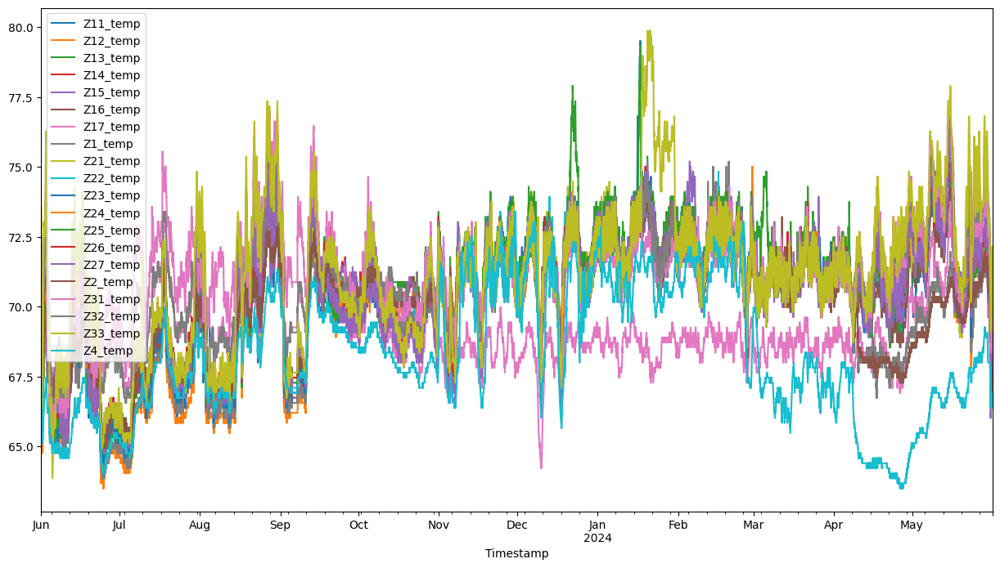

In [6]:
Zone_Temp.plot(figsize=(15, 8))

In [7]:
#Check the range of timestamps (start to end)
print(Zone_Temp.index.min(), Zone_Temp.index.max())

2023-06-01 00:00:00-04:00 2024-05-31 23:59:00-04:00


In [8]:
Zone_Temp.describe()

c:\Users\Sang\AppData\Local\Programs\Python\Python312\Lib\site-packages\pandas\core\nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
c:\Users\Sang\AppData\Local\Programs\Python\Python312\Lib\site-packages\pandas\core\nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
c:\Users\Sang\AppData\Local\Programs\Python\Python312\Lib\site-packages\pandas\core\nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
c:\Users\Sang\AppData\Local\Programs\Python\Python312\Lib\site-packages\pandas\core\nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
c:\Users\Sang\AppData\Local\Programs\Python\Python312\Lib\site-packages\pandas\core\nanops.py:1016: RuntimeWarning: invalid value encountered in subtract
  sqr = _ensure_numeric((avg - values) ** 2)
c:\Us

,Z11_temp,Z12_temp,Z13_temp,Z14_temp,Z15_temp,Z16_temp,Z17_temp,Z1_temp,Z21_temp,Z22_temp,Z23_temp,Z24_temp,Z25_temp,Z26_temp,Z27_temp,Z2_temp,Z31_temp,Z32_temp,Z33_temp,Z4_temp
count,5.270400e+05,5.270400e+05,5.270400e+05,527040.000000,527040.000000,527040.000000,527040.000000,5.270400e+05,5.270400e+05,5.270400e+05,5.270400e+05,5.270400e+05,5.270400e+05,5.270400e+05,5.270400e+05,5.270400e+05,5.270400e+05,5.270400e+05,5.270400e+05,5.270400e+05
mean,inf,inf,inf,70.730405,70.570536,70.353982,69.096714,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf
std,NaN,NaN,NaN,1.961251,2.107135,2.096084,1.337875,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,6.403999e+01,6.350000e+01,6.421999e+01,64.939995,64.219994,64.399994,64.219994,6.386000e+01,6.475999e+01,6.439999e+01,6.439999e+01,6.475999e+01,6.475999e+01,6.493999e+01,6.475999e+01,6.493999e+01,6.602000e+01,6.656000e+01,6.386000e+01,6.350000e+01
25%,6.907999e+01,6.980000e+01,6.962000e+01,69.979996,69.979996,69.259995,68.360001,6.836000e+01,6.925999e+01,6.943999e+01,6.925999e+01,6.925999e+01,6.907999e+01,6.925999e+01,6.907999e+01,6.871999e+01,7.034000e+01,7.016000e+01,6.962000e+01,6.673999e+01
50%,7.052000e+01,7.088000e+01,7.088000e+01,71.059998,71.059998,70.699997,68.899994,7.052000e+01,7.106000e+01,7.088000e+01,7.088000e+01,7.088000e+01,7.070000e+01,7.070000e+01,7.088000e+01,7.034000e+01,7.142000e+01,7.123999e+01,7.123999e+01,6.800000e+01
75%,7.160000e+01,7.196000e+01,7.196000e+01,71.959999,71.959999,71.779999,69.619995,7.142000e+01,7.213999e+01,7.196000e+01,7.196000e+01,7.196000e+01,7.196000e+01,7.196000e+01,7.196000e+01,7.142000e+01,7.213999e+01,7.250000e+01,7.250000e+01,7.034000e+01
max,inf,inf,inf,75.739990,75.559998,74.839996,73.939995,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf


In [9]:
Zone_Temp.replace([np.inf, -np.inf], np.nan, inplace=True)
Zone_Temp.describe()

,Z11_temp,Z12_temp,Z13_temp,Z14_temp,Z15_temp,Z16_temp,Z17_temp,Z1_temp,Z21_temp,Z22_temp,Z23_temp,Z24_temp,Z25_temp,Z26_temp,Z27_temp,Z2_temp,Z31_temp,Z32_temp,Z33_temp,Z4_temp
count,527039.000000,527039.000000,527039.000000,527040.000000,527040.000000,527040.000000,527040.000000,527038.000000,527039.000000,527039.000000,527039.000000,527039.000000,527038.000000,527038.000000,527038.000000,527038.000000,527039.000000,527038.000000,527038.000000,527039.000000
mean,70.082987,70.366474,70.497396,70.730405,70.570536,70.353982,69.096714,69.941701,70.623474,70.543917,70.486100,70.516867,70.466552,70.425613,70.466792,70.114197,71.325355,71.200849,71.136649,68.298841
std,2.170829,2.307636,2.217818,1.961251,2.107135,2.096084,1.337875,2.189755,2.135327,2.200908,2.220068,2.126263,2.257143,2.024674,2.168518,1.873323,1.652193,1.790725,2.489376,2.301734
min,64.039993,63.500000,64.219994,64.939995,64.219994,64.399994,64.219994,63.860001,64.759995,64.399994,64.399994,64.759995,64.759995,64.939995,64.759995,64.939995,66.019997,66.559998,63.860001,63.500000
25%,69.079994,69.799995,69.619995,69.979996,69.979996,69.259995,68.360001,68.360001,69.259995,69.439995,69.259995,69.259995,69.079994,69.259995,69.079994,68.719994,70.339996,70.159996,69.619995,66.739990
50%,70.519997,70.879997,70.879997,71.059998,71.059998,70.699997,68.899994,70.519997,71.059998,70.879997,70.879997,70.879997,70.699997,70.699997,70.879997,70.339996,71.419998,71.239990,71.239990,68.000000
75%,71.599998,71.959999,71.959999,71.959999,71.959999,71.779999,69.619995,71.419998,72.139992,71.959999,71.959999,71.959999,71.959999,71.959999,71.959999,71.419998,72.139992,72.500000,72.500000,70.339996
max,74.839996,74.839996,76.639992,75.739990,75.559998,74.839996,73.939995,75.199997,76.459999,78.619995,79.519997,76.279999,79.339996,76.279999,76.819992,74.479996,77.719994,76.819992,79.879997,73.399994


In [10]:
Lst_name = Zone_Temp.columns.values

In [11]:
for i in range(0,len(Lst_name)):
    df = Zone_Temp[Lst_name[i]]
#     print (df.diff(), q_values[i])
    print (df[abs(df.diff())> 1].index)
    Zone_Temp[Lst_name[i]] = df.drop(df[abs(df.diff())> 1].index)

DatetimeIndex([], dtype='datetime64[ns, US/Eastern]', name='Timestamp', freq='min')
DatetimeIndex([], dtype='datetime64[ns, US/Eastern]', name='Timestamp', freq='min')
DatetimeIndex([], dtype='datetime64[ns, US/Eastern]', name='Timestamp', freq='min')
DatetimeIndex([], dtype='datetime64[ns, US/Eastern]', name='Timestamp', freq='min')
DatetimeIndex([], dtype='datetime64[ns, US/Eastern]', name='Timestamp', freq='min')
DatetimeIndex([], dtype='datetime64[ns, US/Eastern]', name='Timestamp', freq='min')
DatetimeIndex([], dtype='datetime64[ns, US/Eastern]', name='Timestamp', freq='min')
DatetimeIndex([], dtype='datetime64[ns, US/Eastern]', name='Timestamp', freq='min')
DatetimeIndex([], dtype='datetime64[ns, US/Eastern]', name='Timestamp', freq='min')
DatetimeIndex([], dtype='datetime64[ns, US/Eastern]', name='Timestamp', freq='min')
DatetimeIndex([], dtype='datetime64[ns, US/Eastern]', name='Timestamp', freq='min')
DatetimeIndex([], dtype='datetime64[ns, US/Eastern]', name='Timestamp', freq

<Axes: xlabel='Timestamp'>

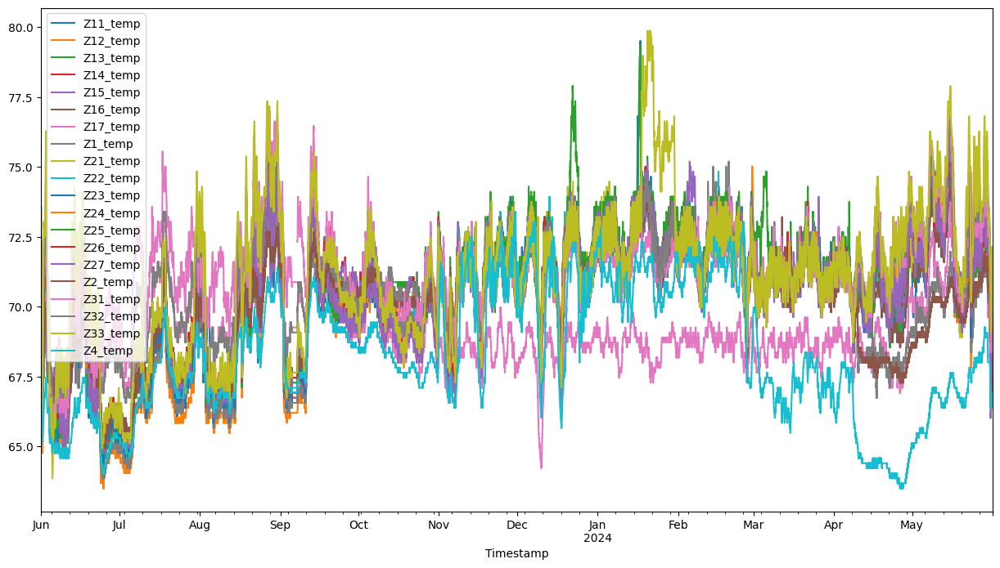

In [12]:
Zone_Temp.plot(figsize=(15, 8))

In [13]:
#Uncomment if necessary (not for year 3 however)
# def replace_repeated_values_with_nan(df, min_streak=10):
#     for column in df.columns:
#         # Track when the value changes
#         changes = df[column].ne(df[column].shift())
        
#         # Create a group for each sequence of repeating values
#         groups = changes.cumsum()
        
#         # Count the size of each group and filter groups with size greater than min_streak
#         filtered_groups = groups.map(groups.value_counts()).where(lambda x: x > min_streak)
        
#         # Replace those groups' values with np.nan
#         df.loc[filtered_groups.notna(), column] = np.nan

In [14]:
# # Apply the function to replace repeated values longer than 24
# replace_repeated_values_with_nan(Zone_Temp, min_streak=24*60)
# Zone_Temp.plot(figsize=(15, 8))

In [15]:
def mahalanobis_distance(x, data):
    """Calculate the Mahalanobis distance for each observation in x from the distribution of data"""
    x_minus_mu = x - np.mean(data)
    cov = np.cov(data.values.T)
    inv_covmat = np.linalg.inv(cov)
    left_term = np.dot(x_minus_mu, inv_covmat)
    mahal = np.dot(left_term, x_minus_mu.T)
    return mahal.diagonal()

def remove_outliers(df, columns):
    # Assuming df has a datetime index, group by year and month
    groups = df.groupby([df.index.year, df.index.month])
    
    # Process each group
    for (year, month), group in groups:
        feature_set = group[columns]
        
        # Skip groups with less data points than columns to avoid singular matrix error
        if feature_set.shape[0] <= feature_set.shape[1]:
            continue
        
        # Compute the Mahalanobis distance for each observation
        group['mahalanobis'] = mahalanobis_distance(x=feature_set, data=feature_set)
        # Calculate the p-value for each Mahalanobis distance
        group['p_value'] = 1 - chi2.cdf(group['mahalanobis'], df=feature_set.shape[1])
        
        # Choose a significance level
        significance_level = 0.005
        # Identify outliers
        outliers = group['p_value'] < significance_level
        # Set outliers to NaN
        df.loc[group[outliers].index, columns] = np.nan
    
    # Drop columns for Mahalanobis distance and p-value if they exist
    df.drop(columns=['mahalanobis', 'p_value'], errors='ignore', inplace=True)
    
    return df

# Define subsets for each zone
Zone_Temp_base = ['Z1_temp', 'Z2_temp', 'Z4_temp']
Zone_Temp_fir = ['Z11_temp', 'Z12_temp', 'Z13_temp', 'Z14_temp', 'Z15_temp', 'Z16_temp', 'Z17_temp']
Zone_Temp_sec = ['Z21_temp', 'Z22_temp', 'Z23_temp', 'Z24_temp', 'Z25_temp', 'Z26_temp', 'Z27_temp']
Zone_Temp_thi = ['Z31_temp', 'Z32_temp', 'Z33_temp']


In [16]:
print(Zone_Temp.index)


DatetimeIndex(['2023-06-01 00:00:00-04:00', '2023-06-01 00:01:00-04:00',
               '2023-06-01 00:02:00-04:00', '2023-06-01 00:03:00-04:00',
               '2023-06-01 00:04:00-04:00', '2023-06-01 00:05:00-04:00',
               '2023-06-01 00:06:00-04:00', '2023-06-01 00:07:00-04:00',
               '2023-06-01 00:08:00-04:00', '2023-06-01 00:09:00-04:00',
               ...
               '2024-05-31 23:50:00-04:00', '2024-05-31 23:51:00-04:00',
               '2024-05-31 23:52:00-04:00', '2024-05-31 23:53:00-04:00',
               '2024-05-31 23:54:00-04:00', '2024-05-31 23:55:00-04:00',
               '2024-05-31 23:56:00-04:00', '2024-05-31 23:57:00-04:00',
               '2024-05-31 23:58:00-04:00', '2024-05-31 23:59:00-04:00'],
              dtype='datetime64[ns, US/Eastern]', name='Timestamp', length=527040, freq='min')


In [17]:
print(Zone_Temp.index.min(), Zone_Temp.index.max())

2023-06-01 00:00:00-04:00 2024-05-31 23:59:00-04:00


In [18]:
Zone_Temp

,Z11_temp,Z12_temp,Z13_temp,Z14_temp,Z15_temp,Z16_temp,Z17_temp,Z1_temp,Z21_temp,Z22_temp,Z23_temp,Z24_temp,Z25_temp,Z26_temp,Z27_temp,Z2_temp,Z31_temp,Z32_temp,Z33_temp,Z4_temp
Timestamp,,,,,,,,,,,,,,,,,,,,
2023-06-01 00:00:00-04:00,71.059998,71.599998,72.319992,72.319992,72.319992,71.599998,70.699997,70.699997,71.959999,71.239990,71.779999,71.599998,71.599998,71.419998,71.779999,69.979996,72.139992,72.500000,73.579994,67.459999
2023-06-01 00:01:00-04:00,71.059998,71.599998,72.319992,72.319992,72.319992,71.599998,70.699997,70.699997,71.959999,71.239990,71.779999,71.599998,71.599998,71.419998,71.779999,69.979996,72.139992,72.500000,73.579994,67.459999
2023-06-01 00:02:00-04:00,71.059998,71.599998,72.319992,72.319992,72.319992,71.599998,70.699997,70.699997,71.959999,71.239990,71.779999,71.599998,71.599998,71.419998,71.779999,69.979996,72.139992,72.500000,73.579994,67.459999
2023-06-01 00:03:00-04:00,71.059998,71.599998,72.319992,72.319992,72.319992,71.599998,70.699997,70.699997,71.959999,71.239990,71.779999,71.599998,71.599998,71.419998,71.779999,69.979996,72.139992,72.500000,73.579994,67.459999
2023-06-01 00:04:00-04:00,71.059998,71.599998,72.139992,72.319992,72.319992,71.599998,70.699997,70.519997,71.779999,71.239990,71.779999,71.599998,71.419998,71.419998,71.779999,70.159996,72.139992,72.500000,73.579994,67.459999
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-05-31 23:55:00-04:00,68.360001,69.079994,69.439995,69.619995,69.619995,68.899994,68.179993,68.000000,68.719994,68.719994,68.899994,68.899994,68.719994,68.719994,68.899994,68.899994,69.979996,70.339996,71.419998,66.739990
2024-05-31 23:56:00-04:00,68.360001,69.079994,69.259995,69.619995,69.619995,68.899994,68.179993,68.179993,68.719994,68.719994,68.899994,68.899994,68.719994,68.719994,68.899994,68.899994,69.979996,70.339996,71.419998,66.739990
2024-05-31 23:57:00-04:00,68.360001,69.079994,69.259995,69.619995,69.619995,68.899994,68.179993,68.179993,68.719994,68.719994,68.899994,68.899994,68.719994,68.719994,68.899994,68.899994,69.979996,70.339996,71.419998,66.739990


<Axes: xlabel='Timestamp'>

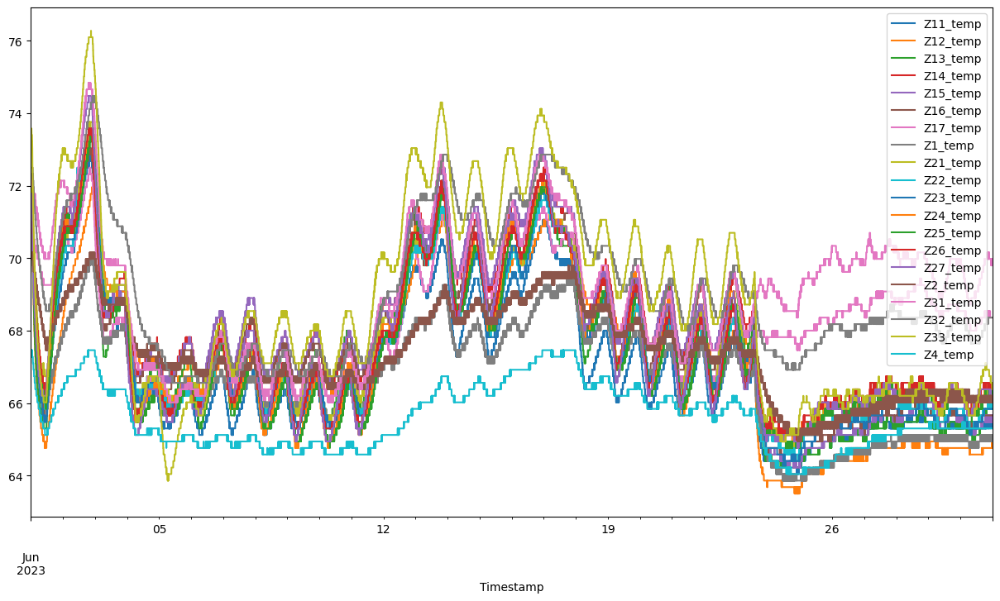

In [19]:
Zone_Temp0 = Zone_Temp["2023-06-01": "2023-06-30"]

Zone_Temp0.plot(figsize=(15, 8))

<Axes: xlabel='Timestamp'>

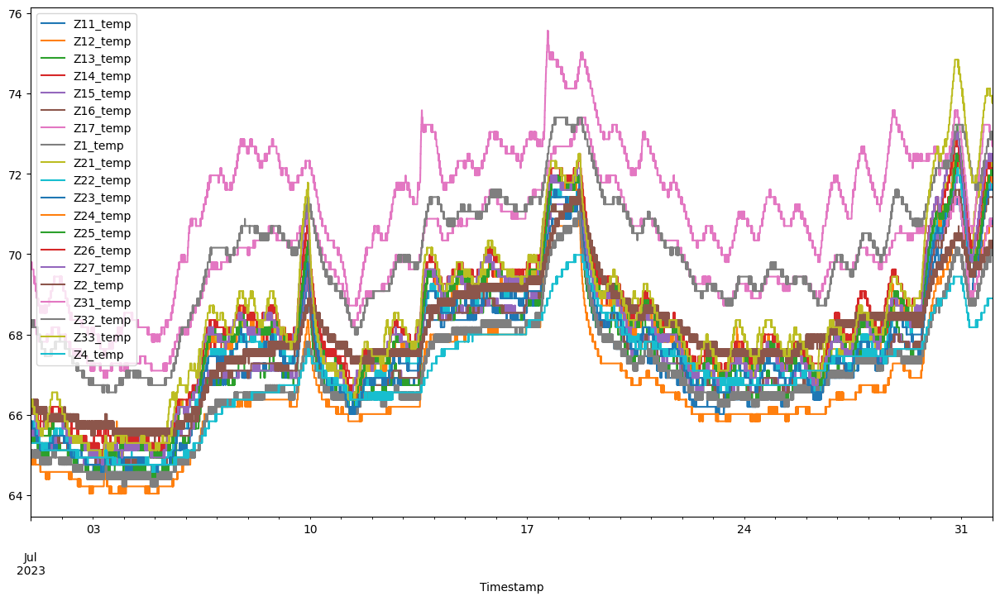

In [20]:
Zone_Temp1 = Zone_Temp["2023-07-01": "2023-07-31"]

Zone_Temp1.plot(figsize=(15, 8))

<Axes: xlabel='Timestamp'>

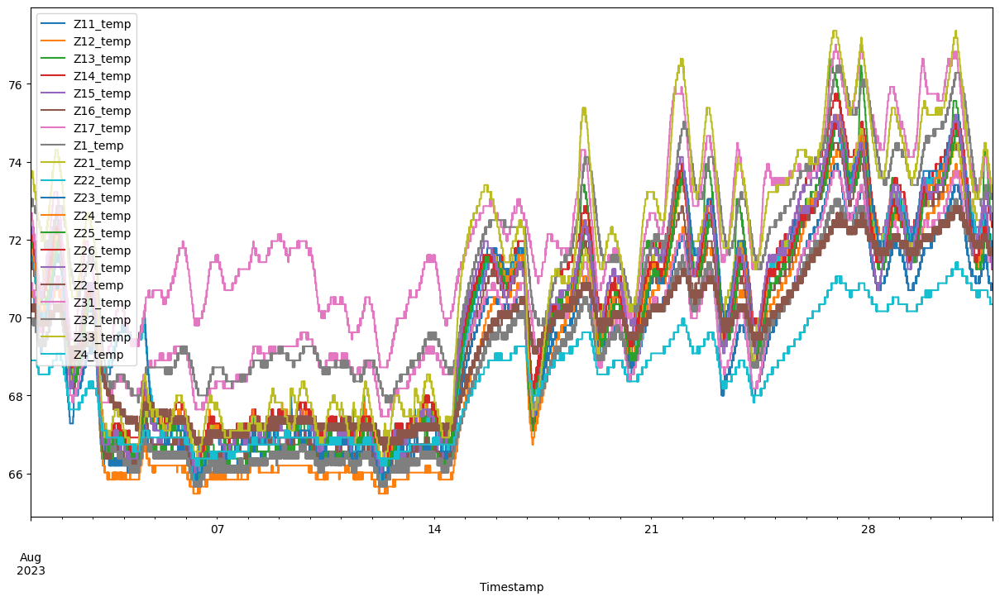

In [21]:
Zone_Temp2 = Zone_Temp["2023-08-01": "2023-08-31"]

Zone_Temp2.plot(figsize=(15, 8))

<Axes: xlabel='Timestamp'>

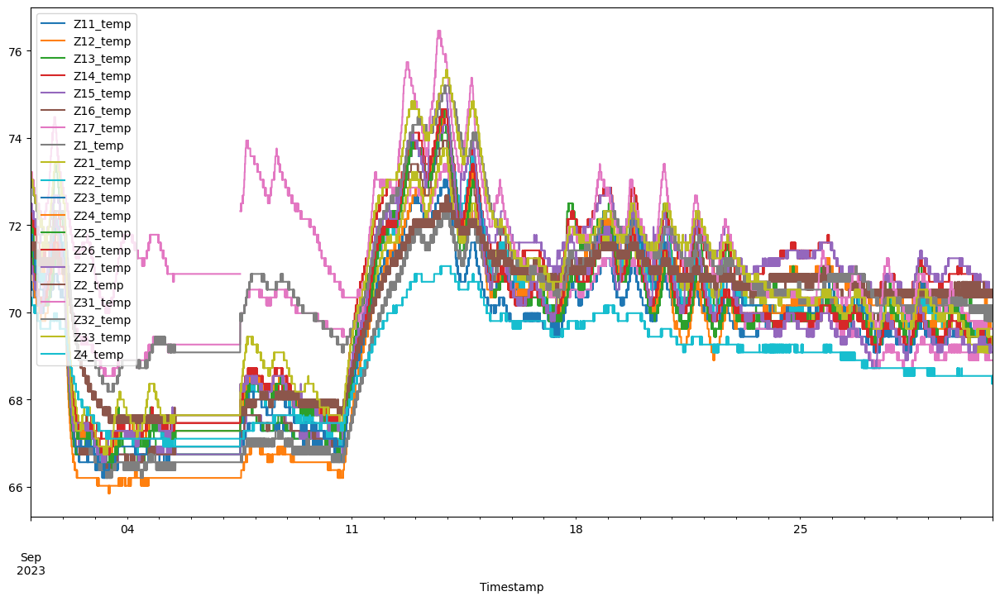

In [22]:
Zone_Temp3 = Zone_Temp["2023-09-01": "2023-09-30"]

Zone_Temp3.plot(figsize=(15, 8))

<Axes: xlabel='Timestamp'>

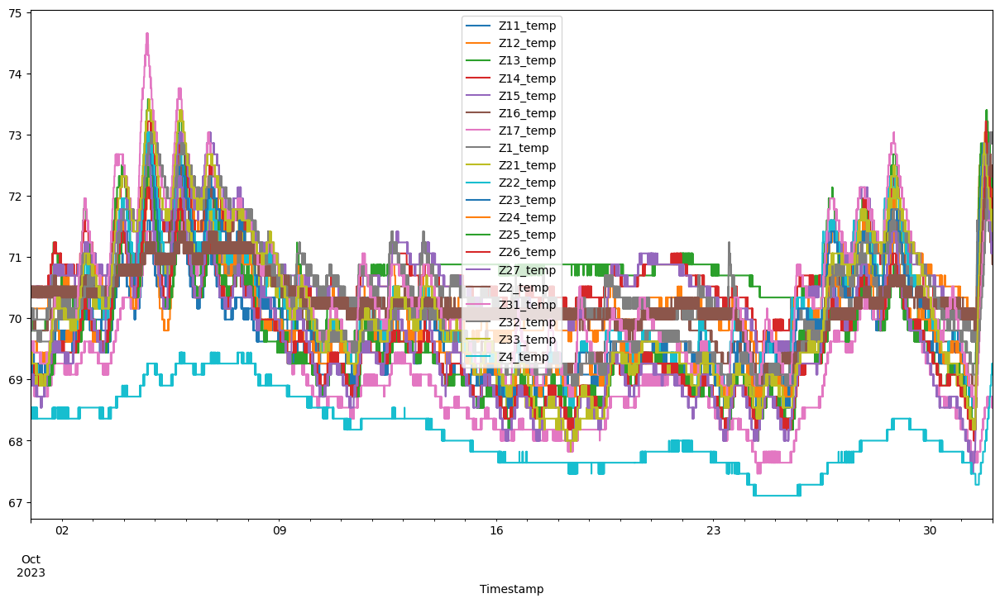

In [23]:
Zone_Temp4 = Zone_Temp["2023-10-01": "2023-10-31"]

Zone_Temp4.plot(figsize=(15, 8))

<Axes: xlabel='Timestamp'>

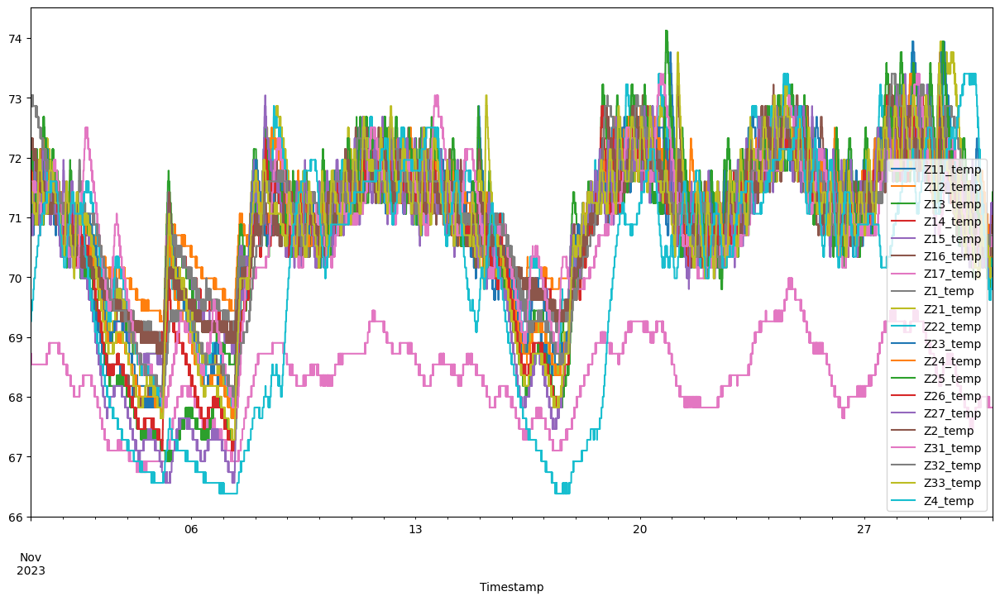

In [24]:
Zone_Temp5 = Zone_Temp["2023-11-01":"2023-11-30"]
Zone_Temp5.plot(figsize=(15, 8))

<Axes: xlabel='Timestamp'>

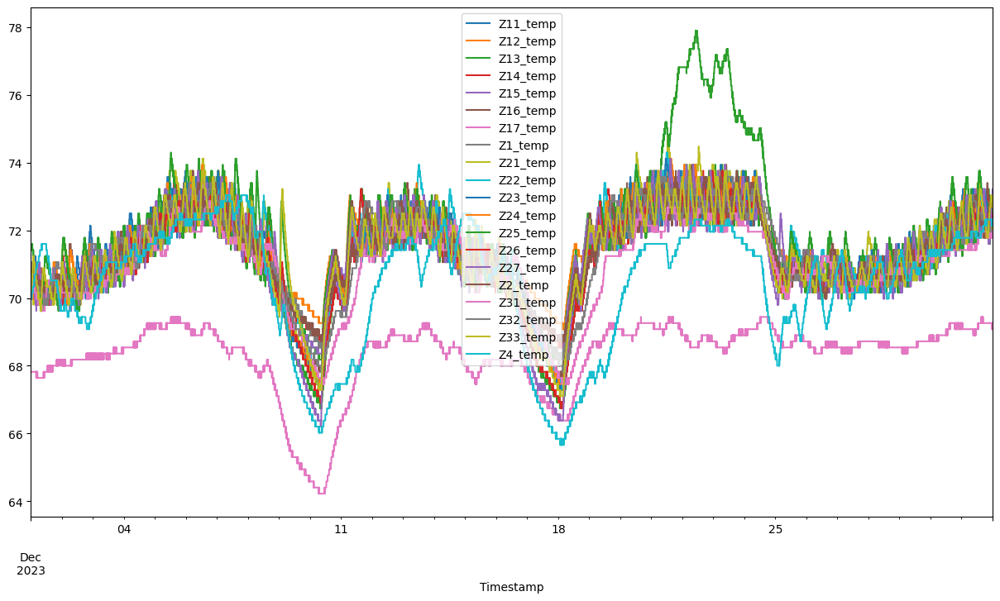

In [25]:
Zone_Temp6 = Zone_Temp["2023-12-01": "2023-12-31"]
Zone_Temp6.plot(figsize=(15, 8))

<Axes: xlabel='Timestamp'>

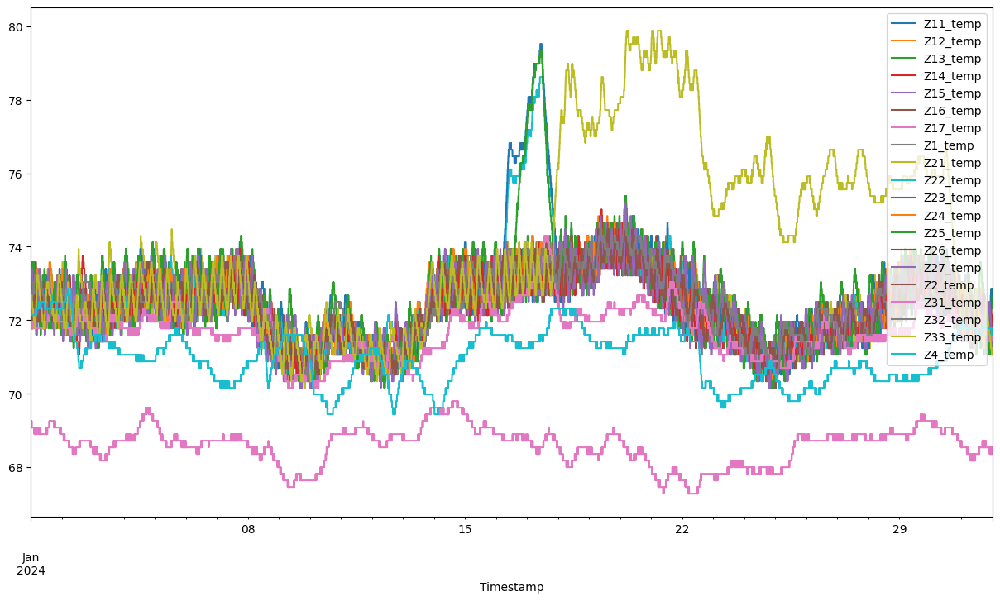

In [26]:
Zone_Temp7 = Zone_Temp["2024-01-01": "2024-01-31"]
Zone_Temp7.plot(figsize=(15, 8))

<Axes: xlabel='Timestamp'>

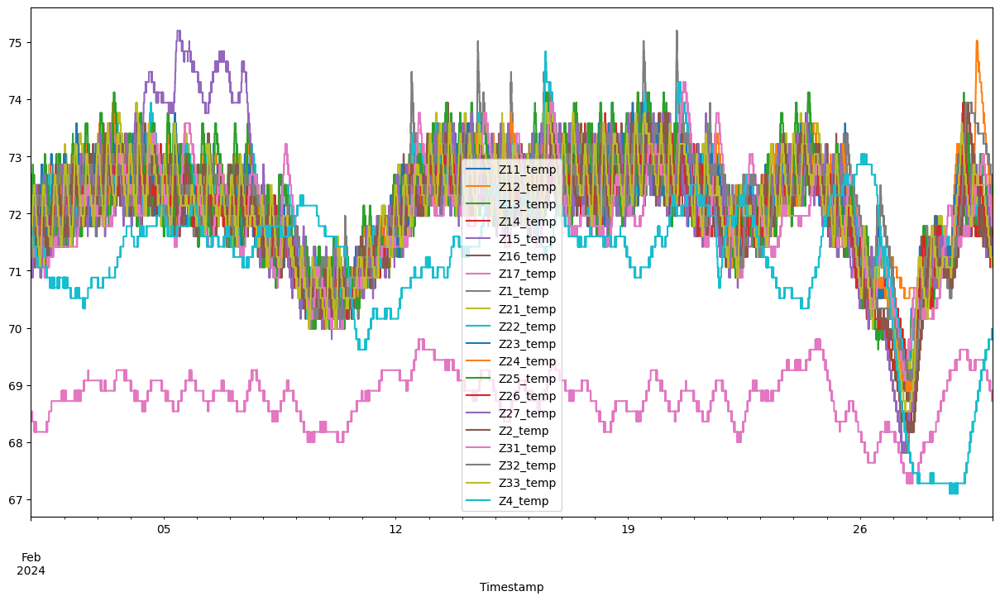

In [27]:
Zone_Temp8 = Zone_Temp["2024-02-01": "2024-02-29"]
Zone_Temp8.plot(figsize=(15, 8))

<Axes: xlabel='Timestamp'>

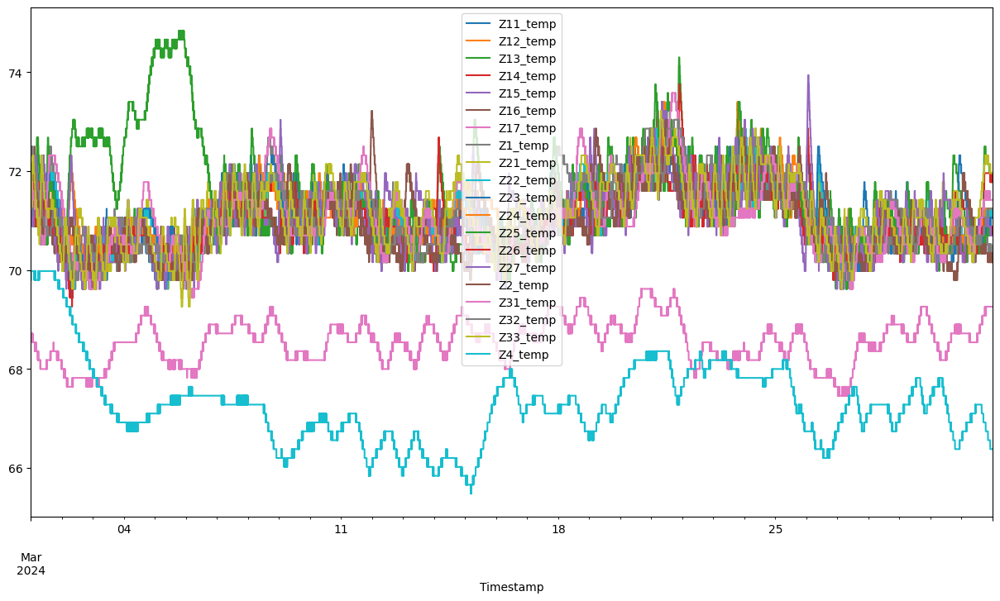

In [28]:
Zone_Temp9 = Zone_Temp["2024-03-01": "2024-03-31"]
Zone_Temp9.plot(figsize=(15, 8))

<Axes: xlabel='Timestamp'>

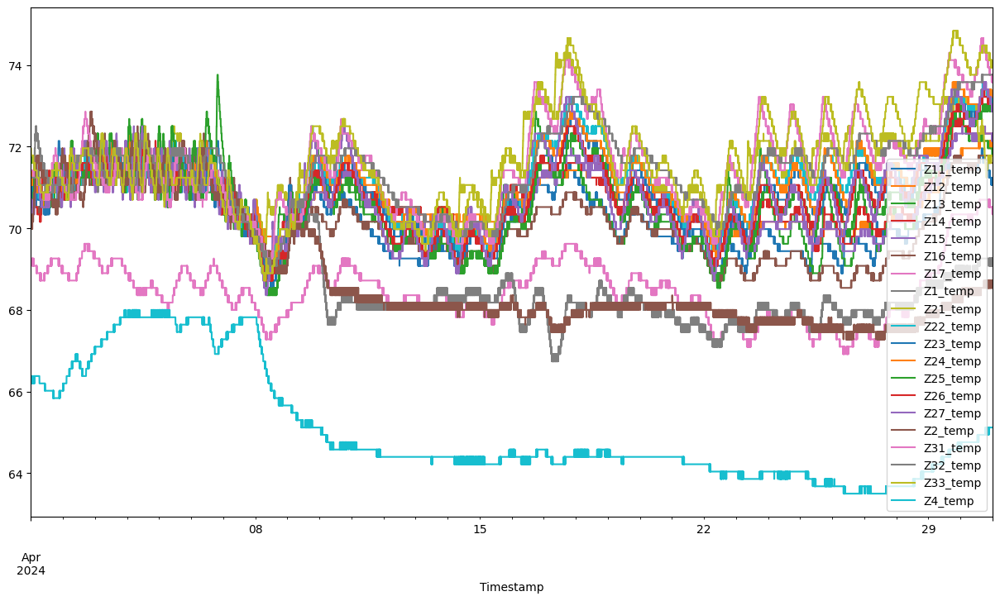

In [29]:
Zone_Temp10 = Zone_Temp["2024-04-01": "2024-04-30"]
Zone_Temp10.plot(figsize=(15, 8))

<Axes: xlabel='Timestamp'>

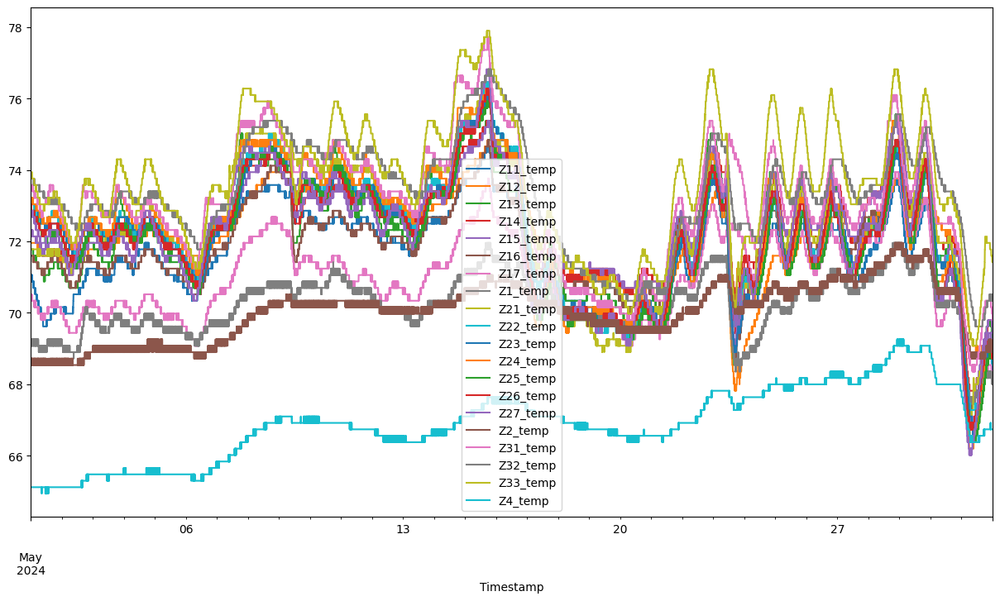

In [30]:
Zone_Temp11 = Zone_Temp["2024-05-01": "2024-05-31"]
Zone_Temp11.plot(figsize=(15, 8))

In [31]:
# Combine all dataframes
combined_df = pd.concat([Zone_Temp0, Zone_Temp1, Zone_Temp2, Zone_Temp3, Zone_Temp4, Zone_Temp5, Zone_Temp6, Zone_Temp7, Zone_Temp8, Zone_Temp9, Zone_Temp10, Zone_Temp11])

<Axes: xlabel='Timestamp'>

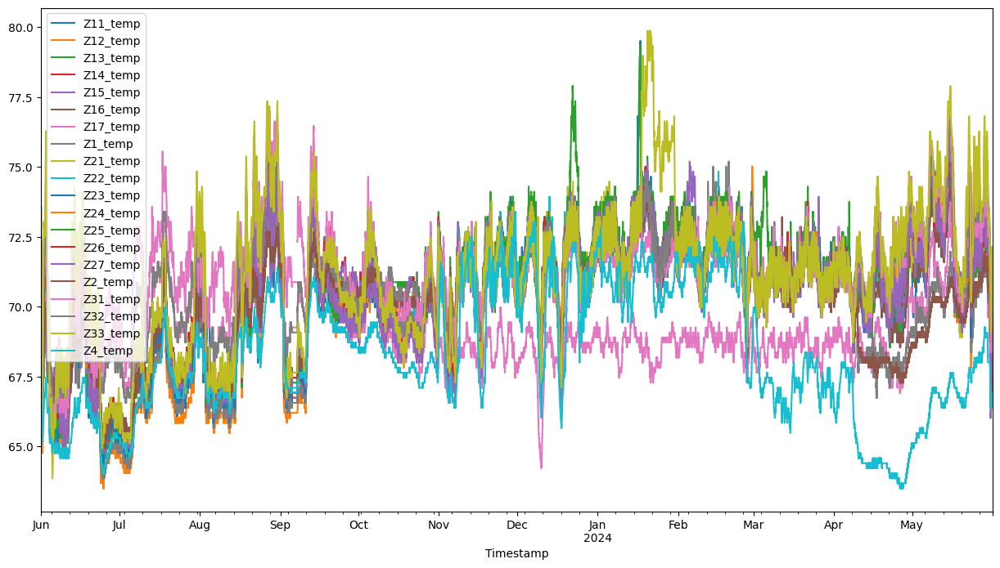

In [32]:
combined_df.plot(figsize=(15, 8))

C:\Users\Sang\AppData\Local\Temp\ipykernel_6464\3631271564.py:1: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  combined_df = combined_df.resample("H").mean().ffill()


<Axes: xlabel='Timestamp'>

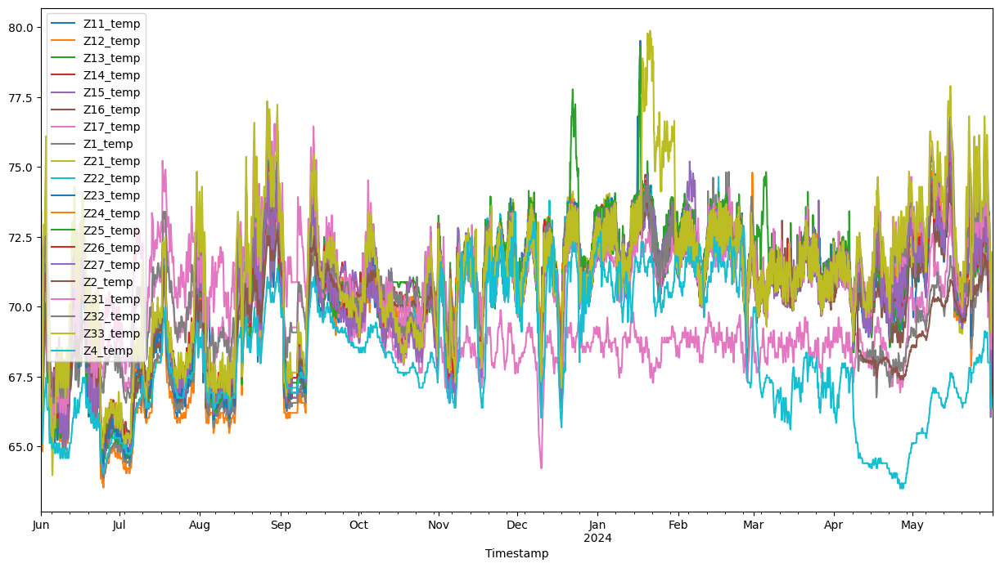

In [33]:
combined_df = combined_df.resample("H").mean().ffill()

combined_df.plot(figsize=(15, 8))

c:\Users\Sang\AppData\Local\Programs\Python\Python312\Lib\site-packages\pandas\plotting\_matplotlib\core.py:580: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = self.plt.figure(figsize=self.figsize)


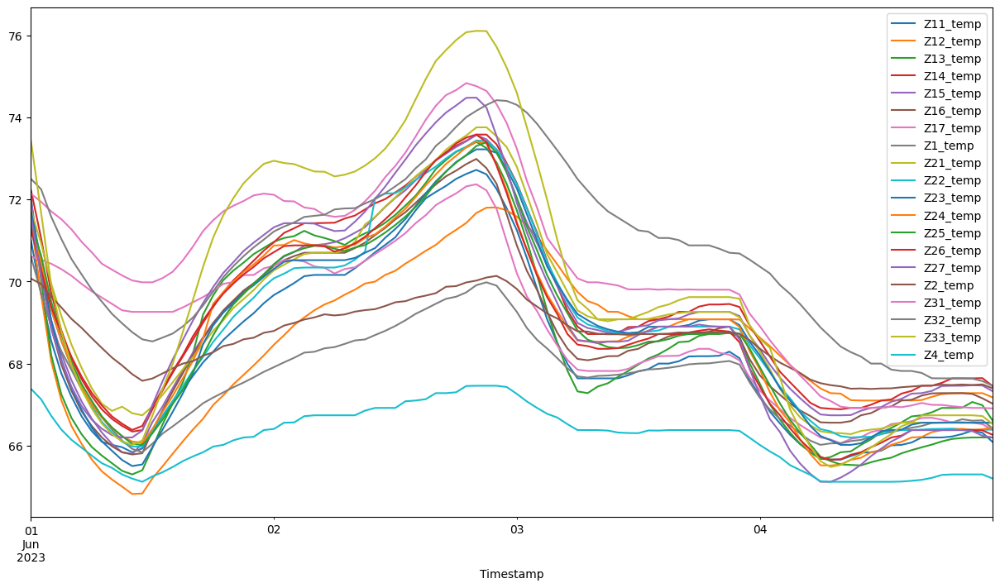

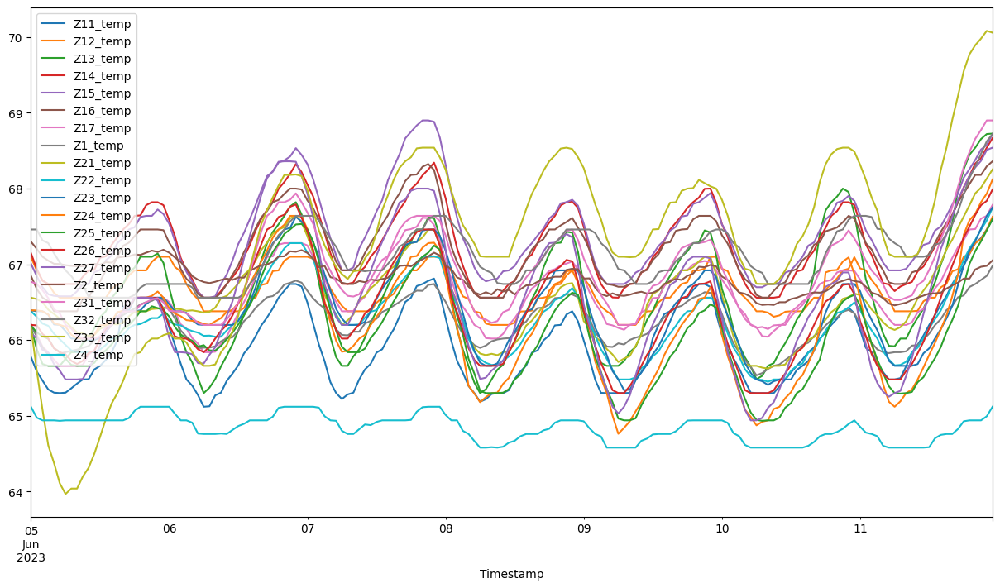

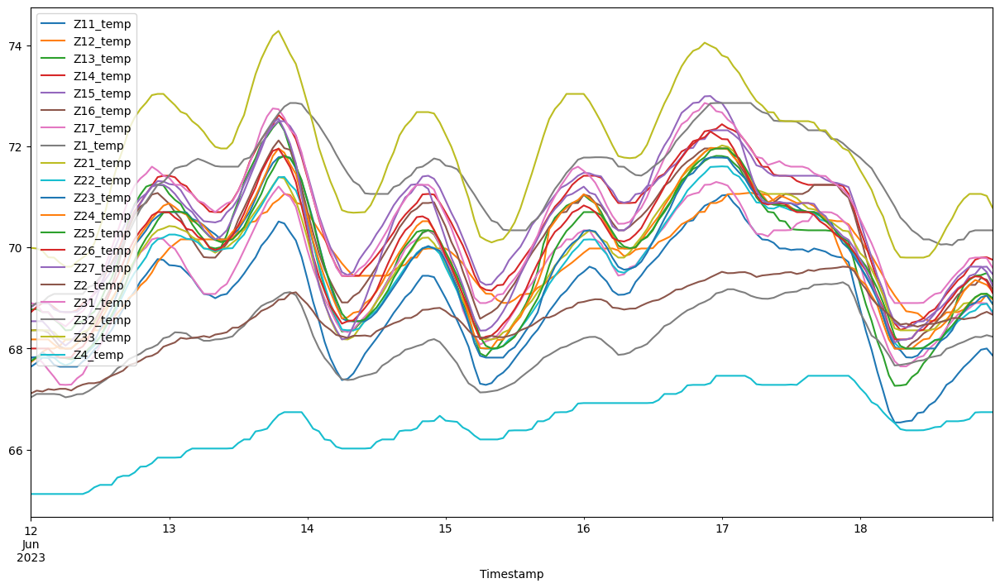

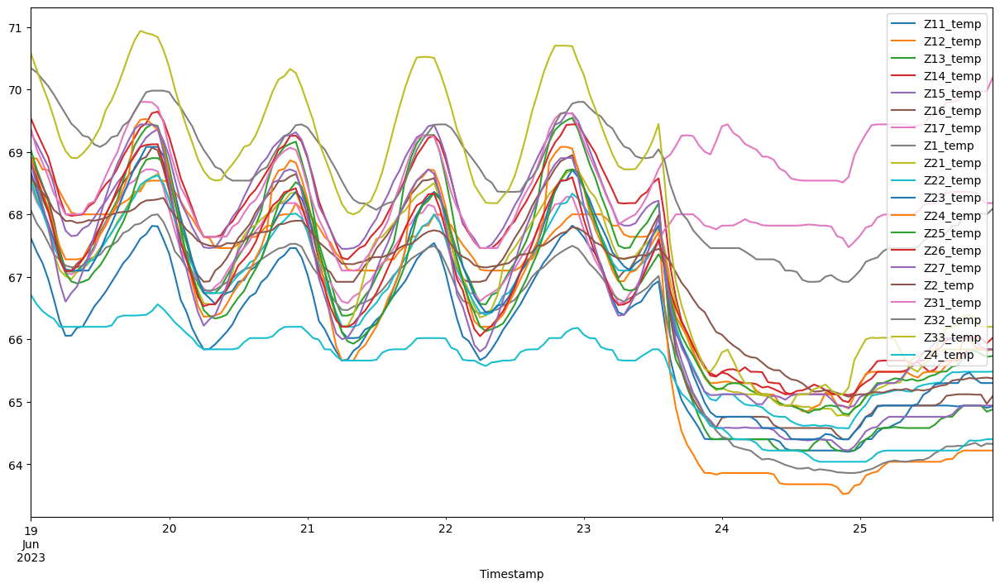

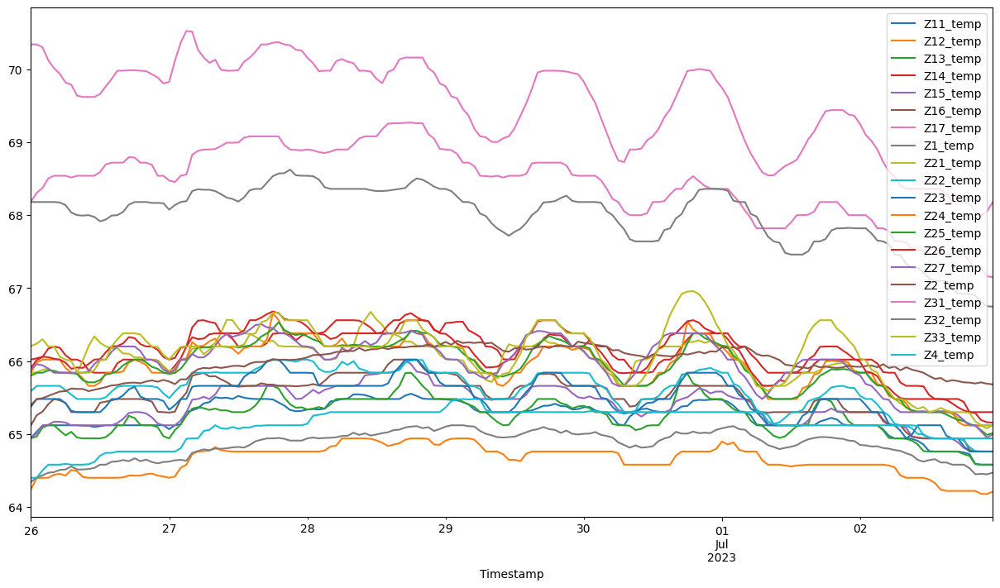

...

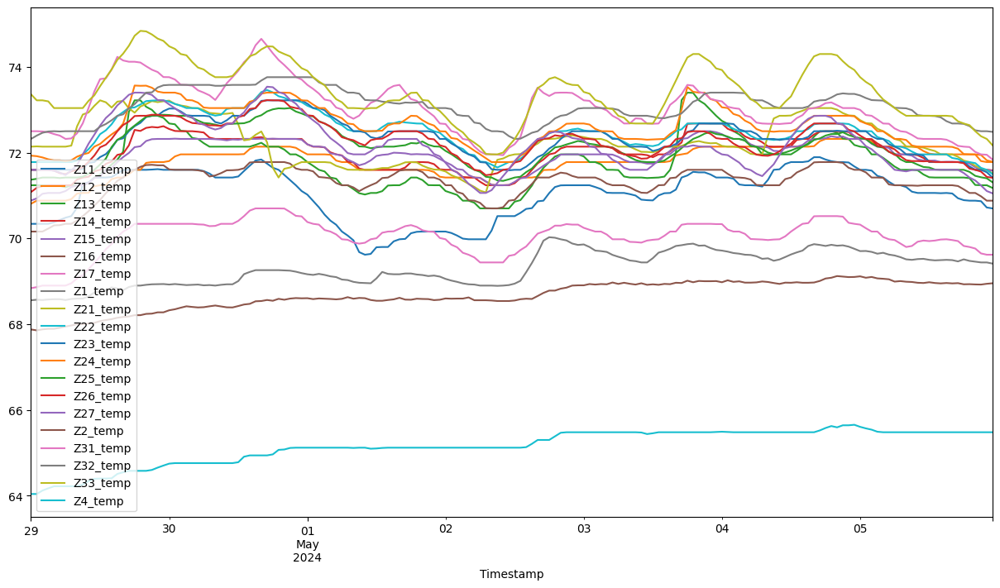

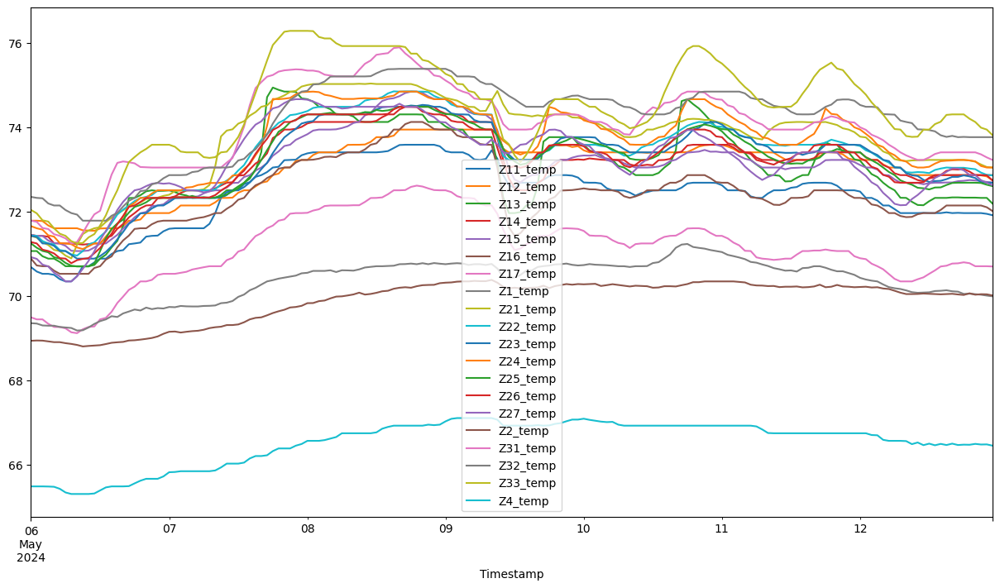

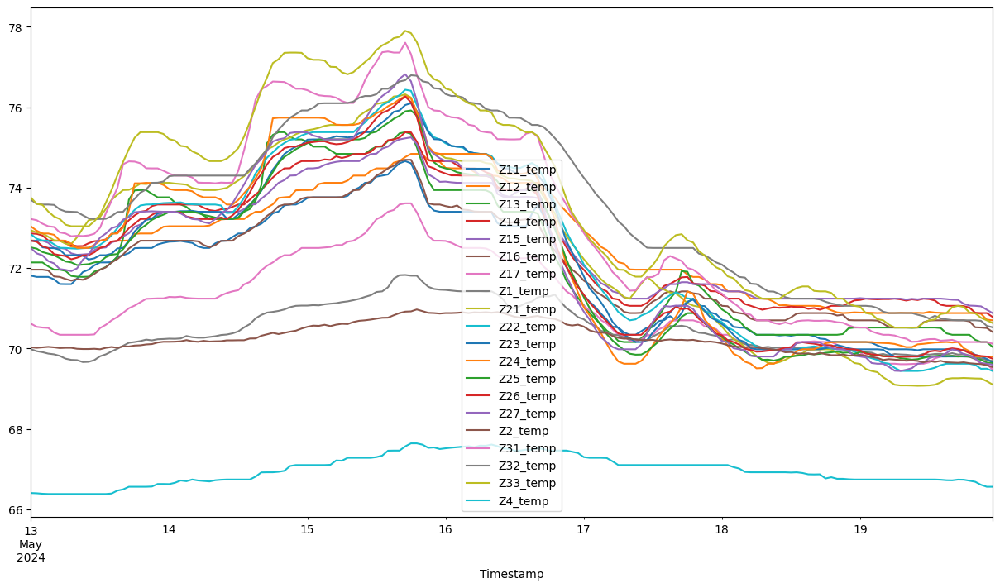

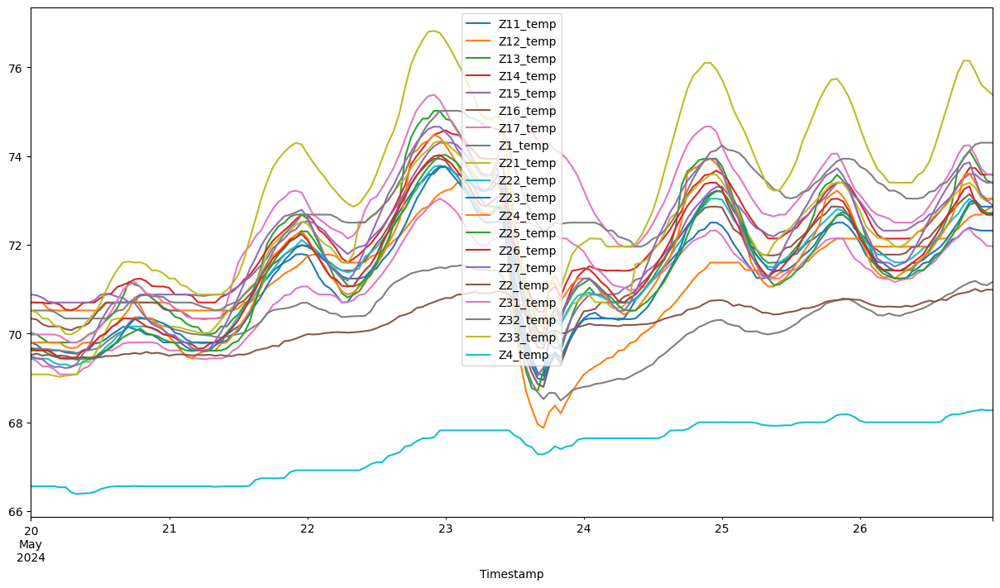

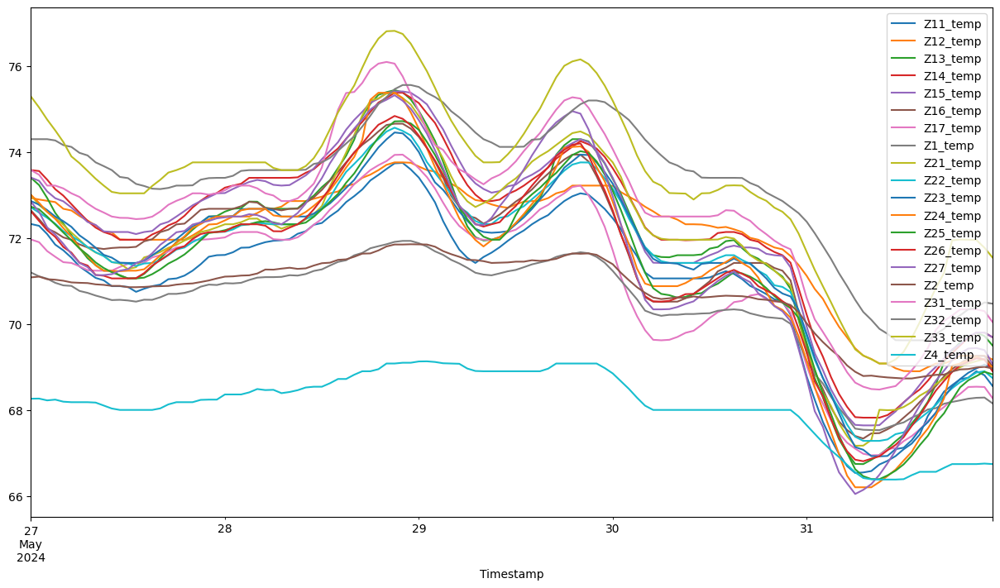

In [34]:
for (year, week), group in combined_df.groupby([combined_df.index.isocalendar().year, combined_df.index.isocalendar().week]):

    group.plot(figsize=(15, 8))
    
# combined_df.plot(figsize=(15, 8))

In [36]:
combined_df.isna().sum()

Z11_temp    0
Z12_temp    0
Z13_temp    0
Z14_temp    0
Z15_temp    0
Z16_temp    0
Z17_temp    0
Z1_temp     0
Z21_temp    0
Z22_temp    0
Z23_temp    0
Z24_temp    0
Z25_temp    0
Z26_temp    0
Z27_temp    0
Z2_temp     0
Z31_temp    0
Z32_temp    0
Z33_temp    0
Z4_temp     0
dtype: int64

<Axes: xlabel='Timestamp'>

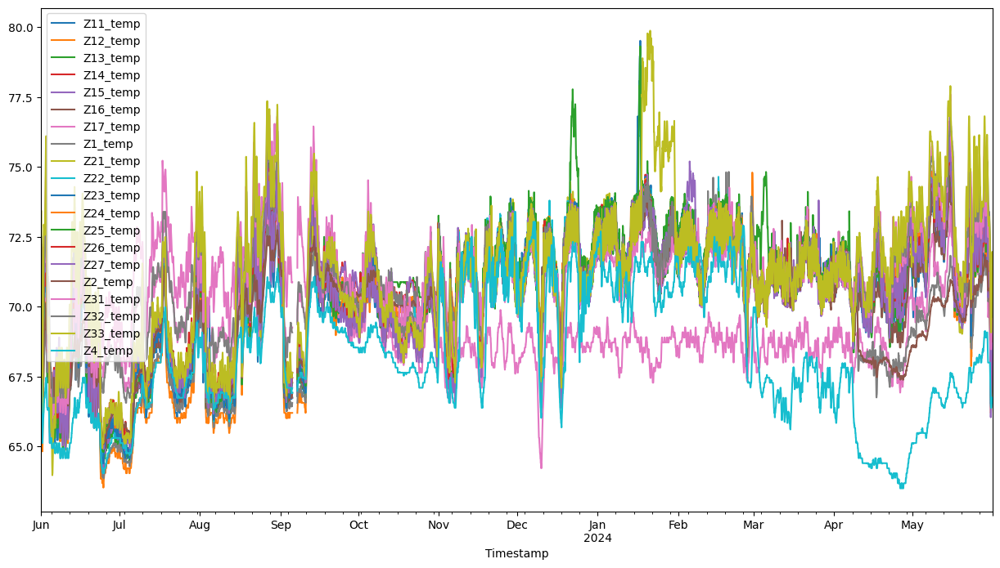

In [37]:
# Detecting rows with repeated values
repeated_index = (combined_df.diff() == 0).all(axis=1)
repeated_rows = combined_df[repeated_index]

# Now let's get the index of the repeated rows
repeated_rows_index = repeated_rows.index.tolist()

combined_df[repeated_index] = np.nan
combined_df.plot(figsize=(15, 8))

In [38]:
combined_df.isna().sum()

Z11_temp    46
Z12_temp    46
Z13_temp    46
Z14_temp    46
Z15_temp    46
Z16_temp    46
Z17_temp    46
Z1_temp     46
Z21_temp    46
Z22_temp    46
Z23_temp    46
Z24_temp    46
Z25_temp    46
Z26_temp    46
Z27_temp    46
Z2_temp     46
Z31_temp    46
Z32_temp    46
Z33_temp    46
Z4_temp     46
dtype: int64

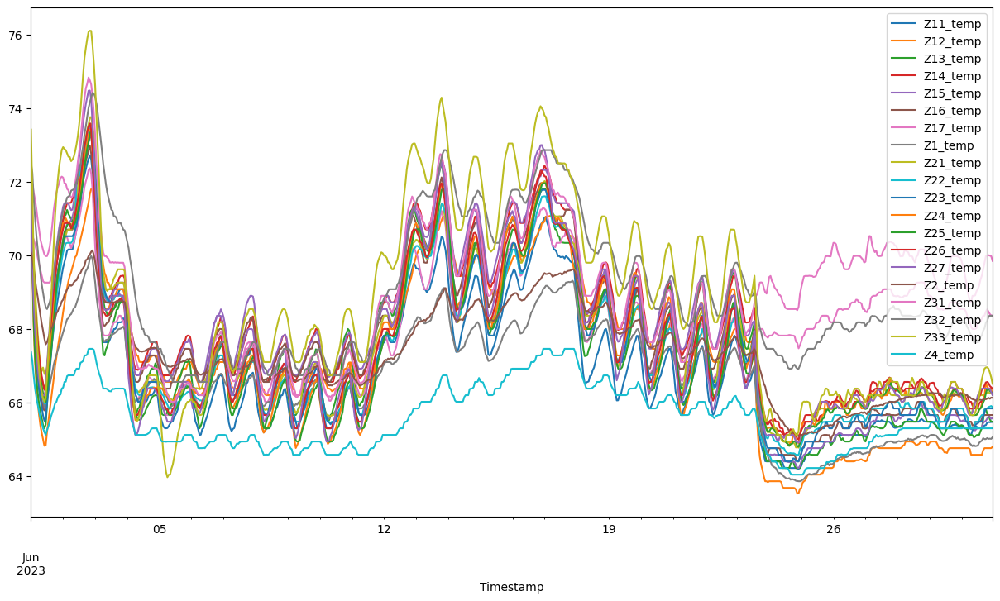

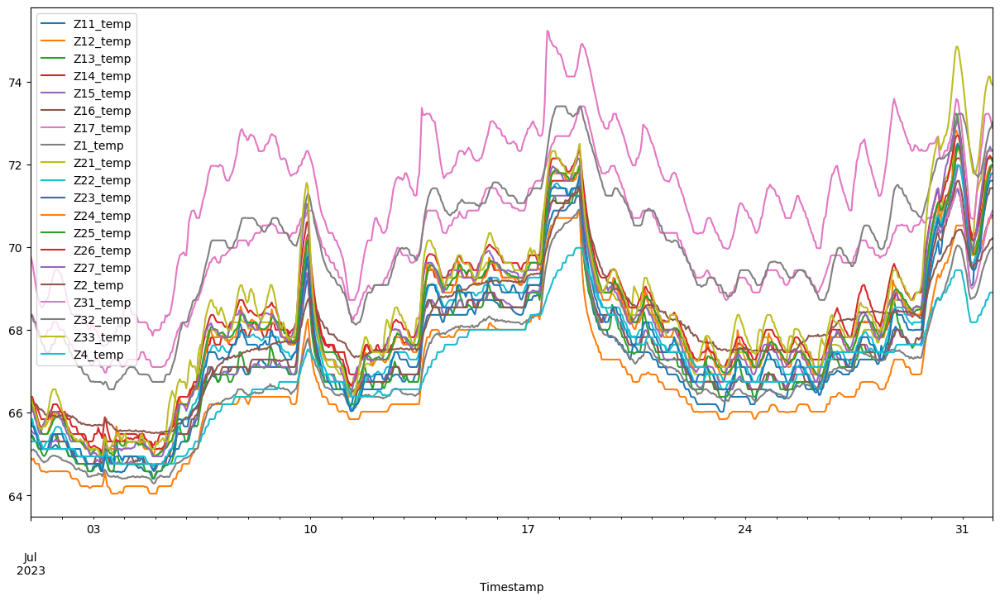

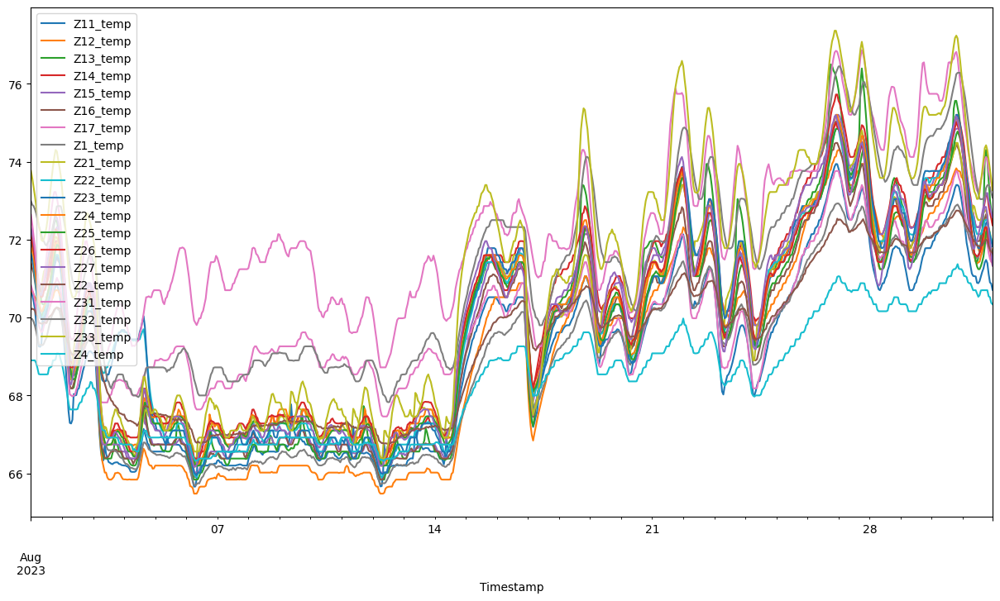

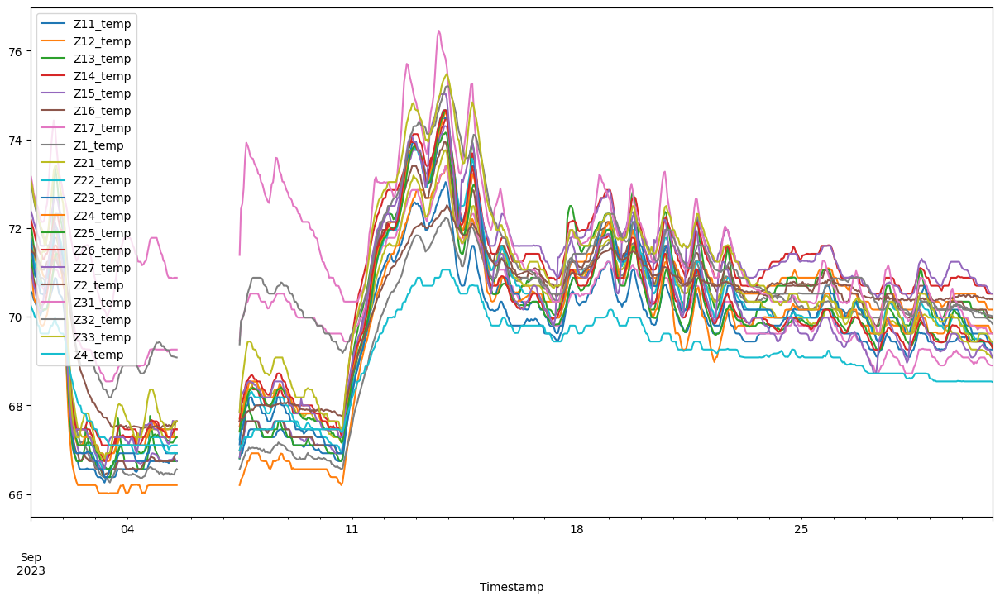

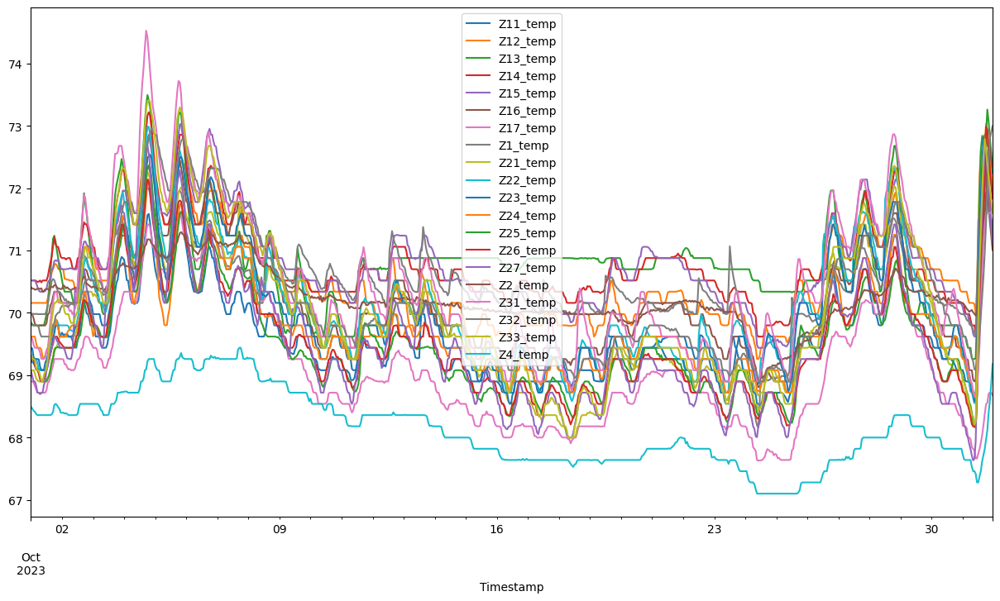

...

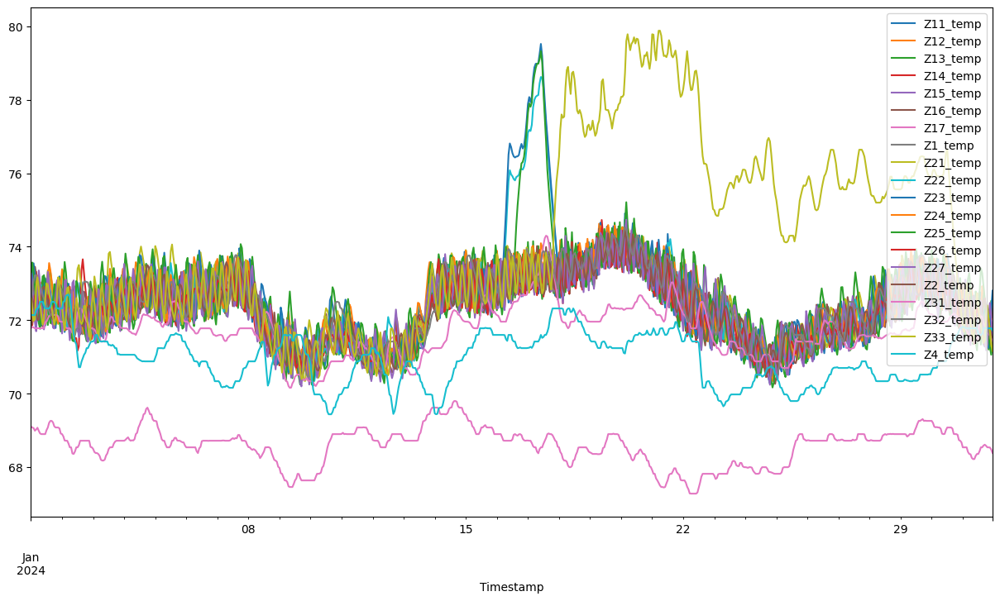

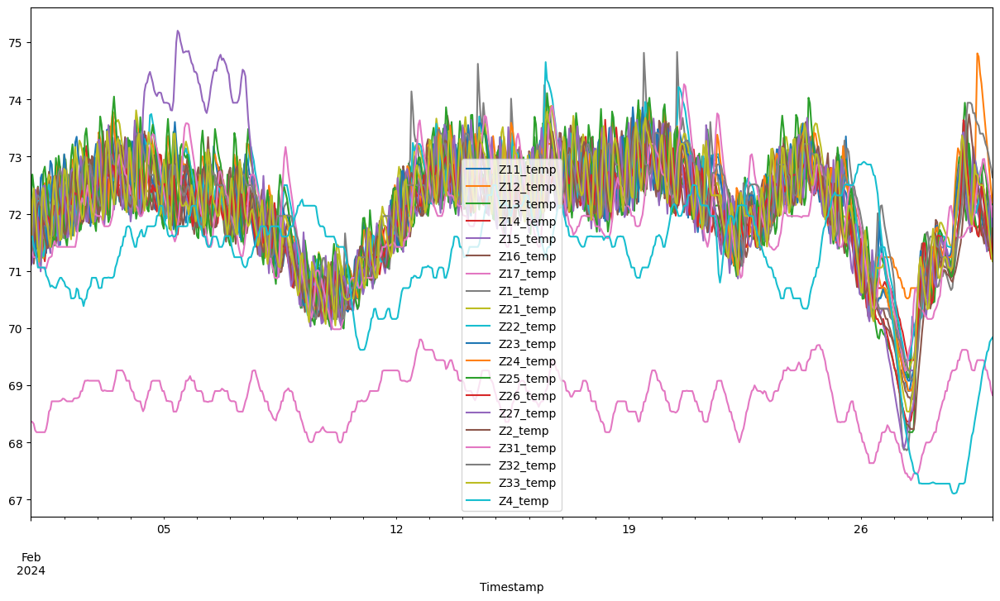

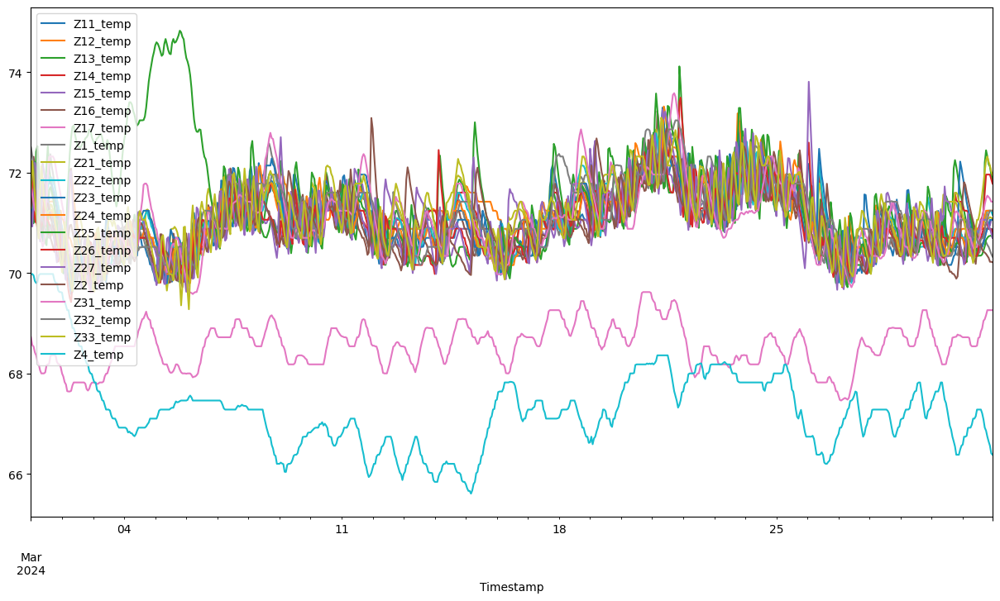

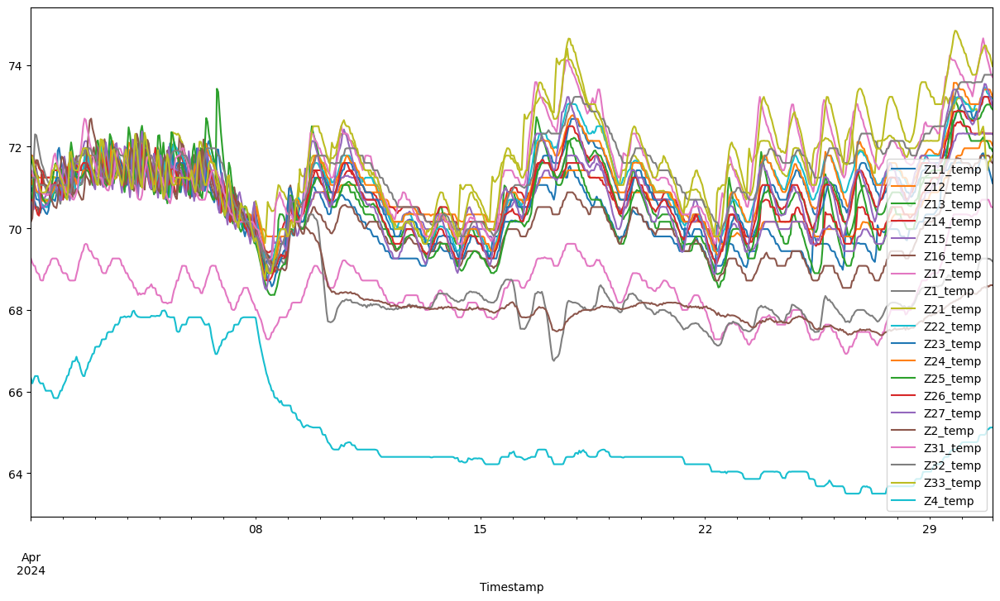

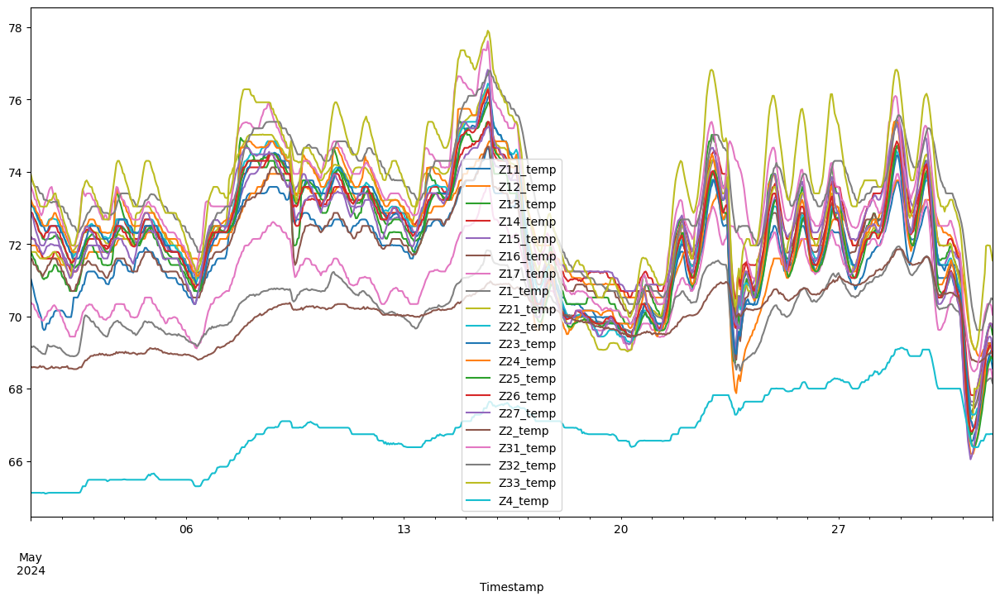

In [39]:
# Then, group by year and week number and apply Mahalanobis distance function
for (year, month), group in combined_df.groupby([combined_df.index.year, combined_df.index.month]):

    group.plot(figsize=(15, 8))

<Axes: xlabel='Timestamp'>

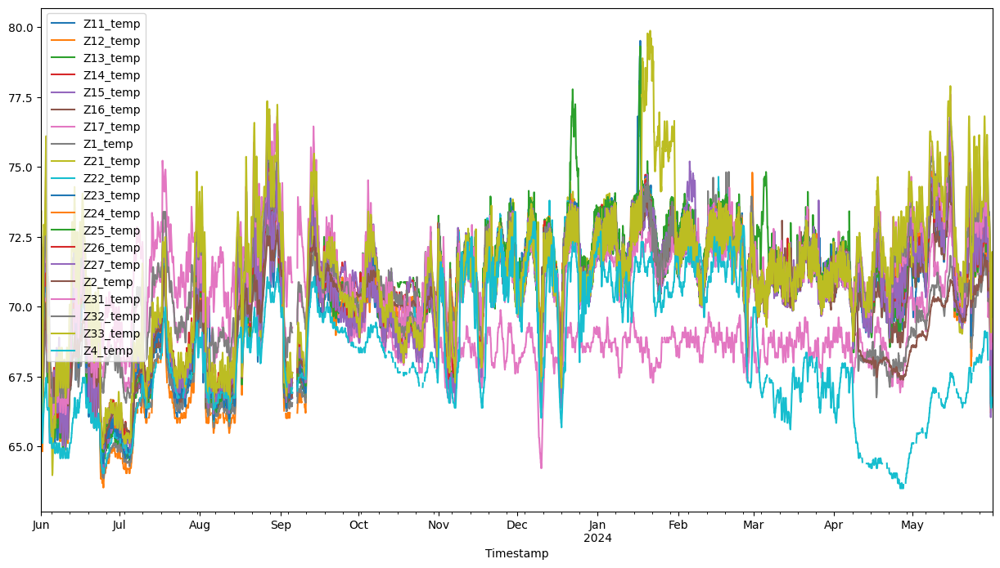

In [40]:
def replace_stuck_values_with_nan(series, threshold=5):
    replaced_values = series.copy()
    count = 1  # Counter for consecutive same values
    for i in range(1, len(series)):
        if series.iloc[i] == series.iloc[i - 1]:
            count += 1
        else:
            if count > threshold:  # Replace with NaN if the count exceeds the threshold
                replaced_values.iloc[i - count:i] = np.nan
            count = 1  # Reset counter if the current value is not the same

    if count > threshold:  # Check at the end of the series
        replaced_values.iloc[-count:] = np.nan

    return replaced_values


def replace_repeated_values_with_nan(df):
    for column in df.columns:
        # Find duplicated values in the column (keep=False marks all duplicates as True)
        duplicates = df[column].duplicated(keep=False)
        # Replace duplicates with NaN
        df.loc[duplicates, column] = np.nan
    return df

for column in combined_df.columns:
    combined_df[column] = replace_stuck_values_with_nan(combined_df[column], threshold=12)
    
combined_df.plot(figsize=(15, 8))

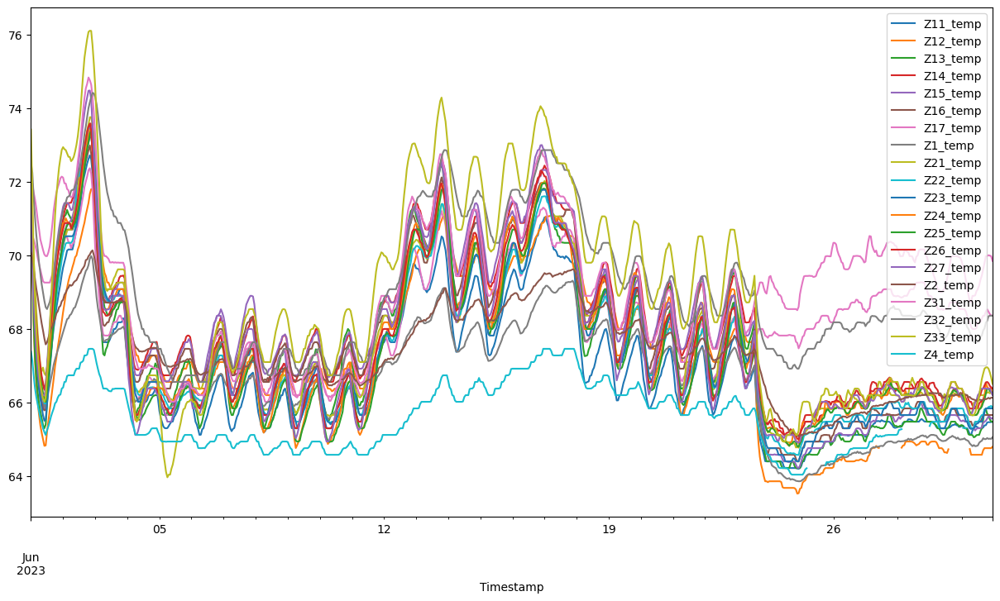

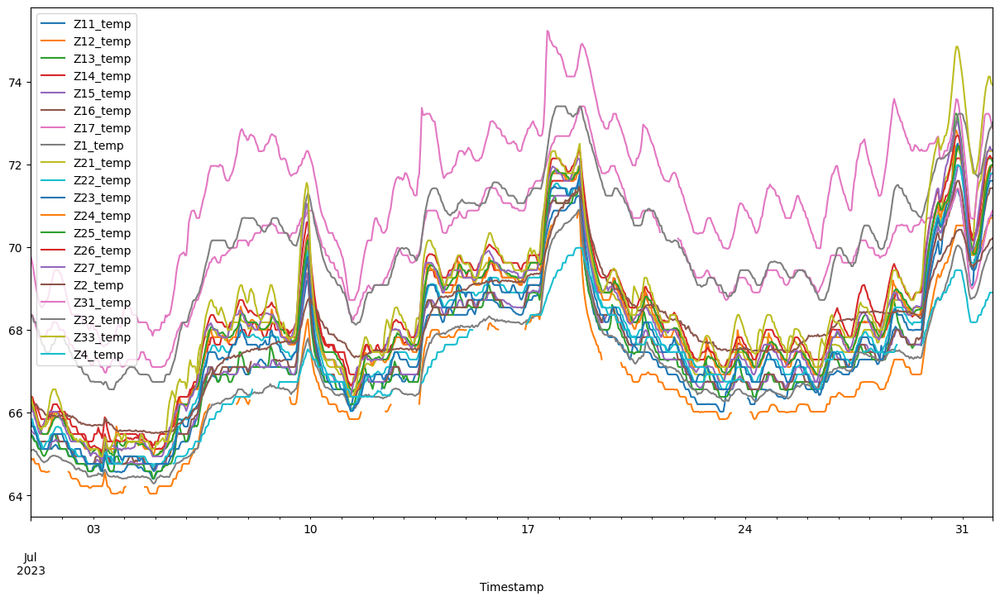

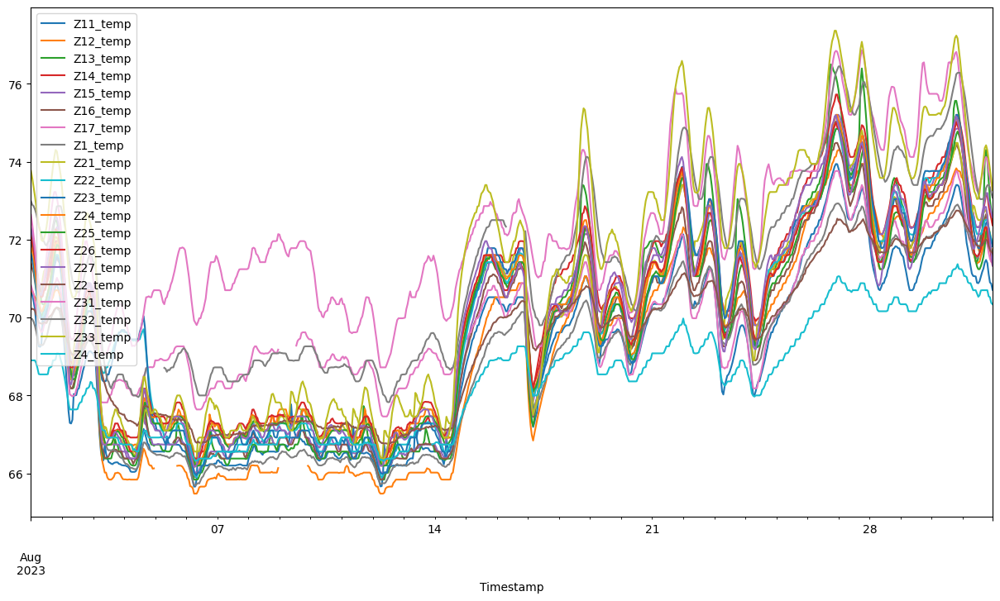

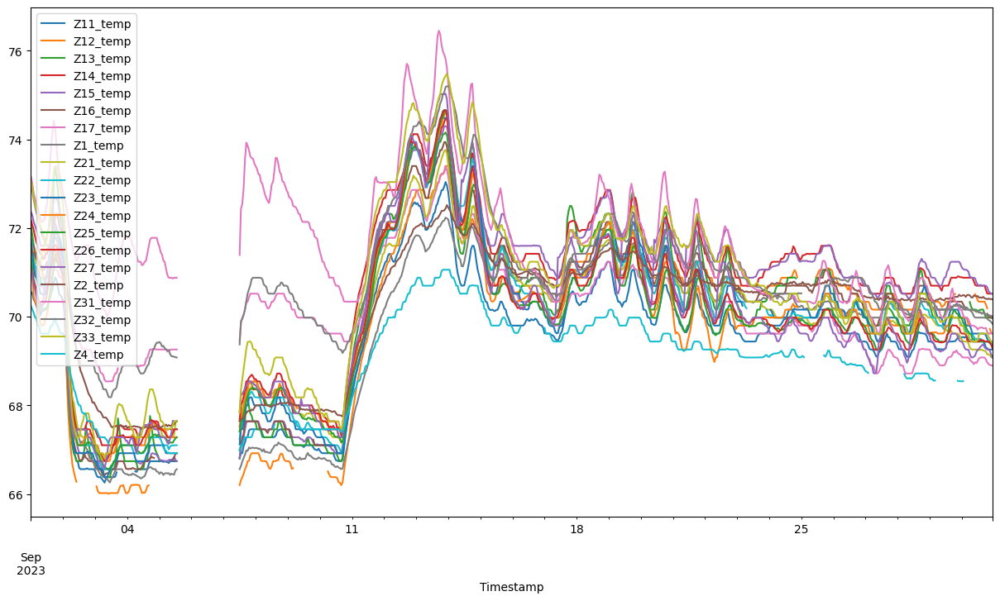

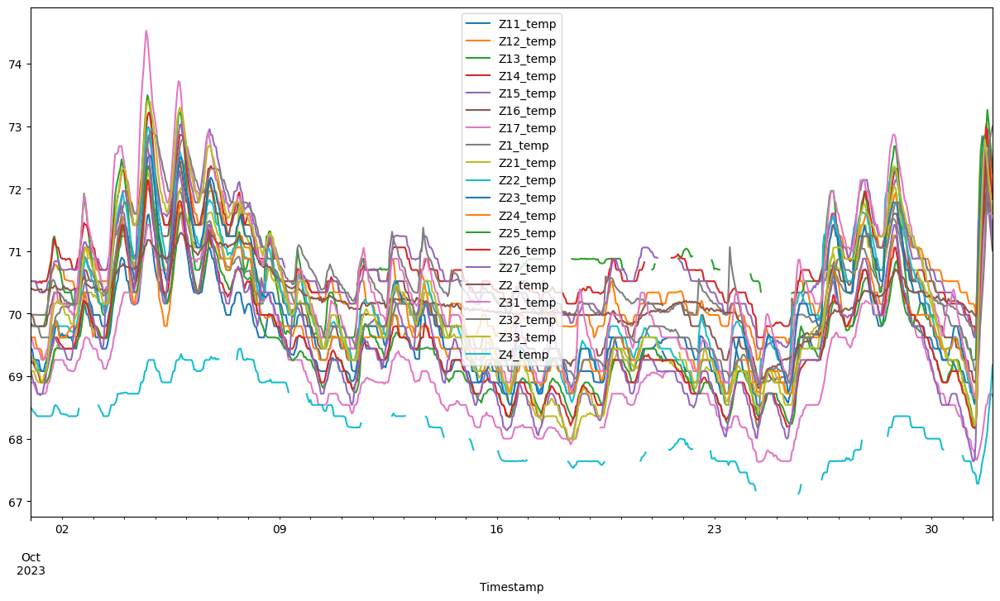

...

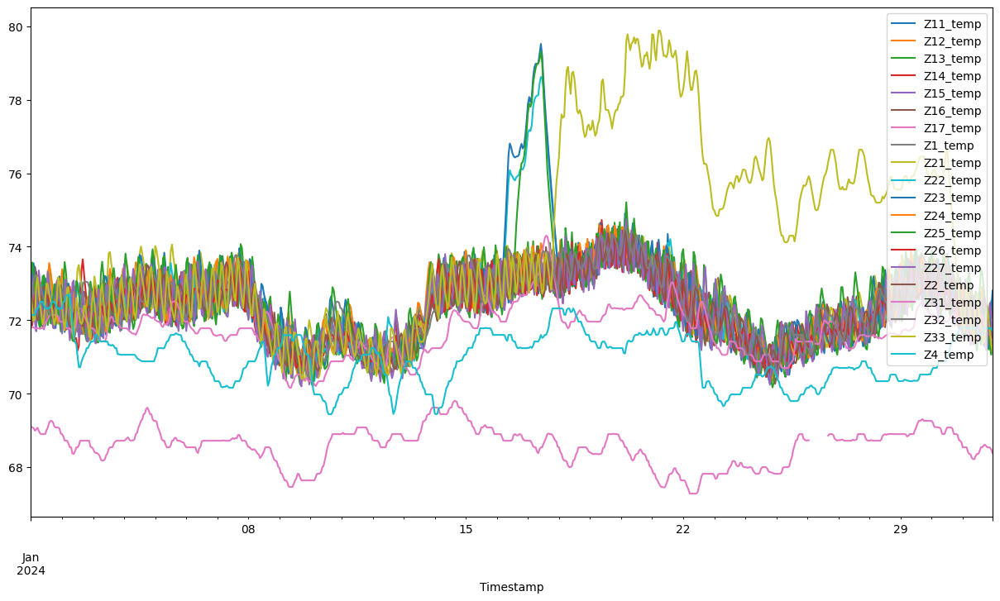

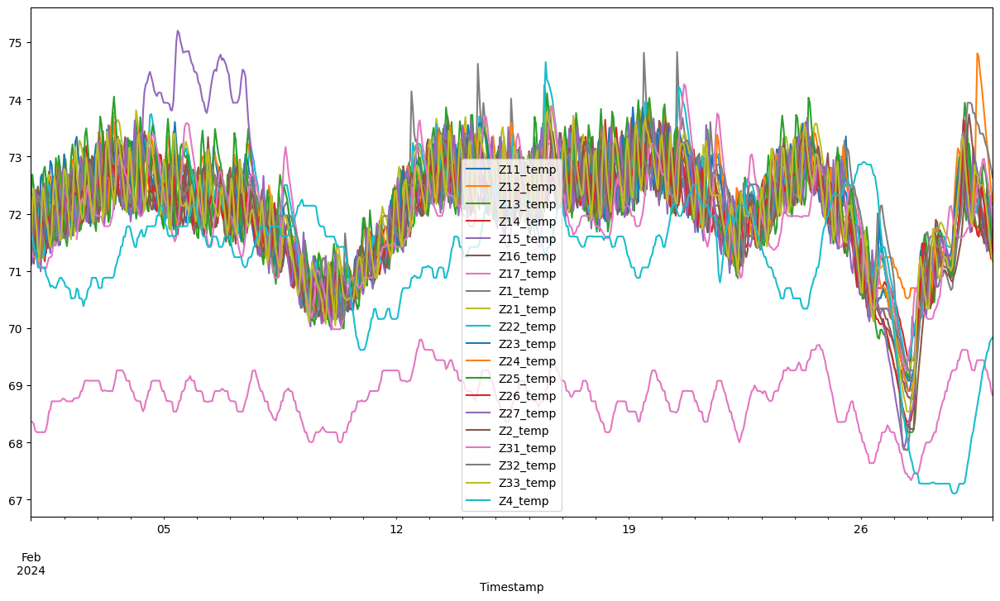

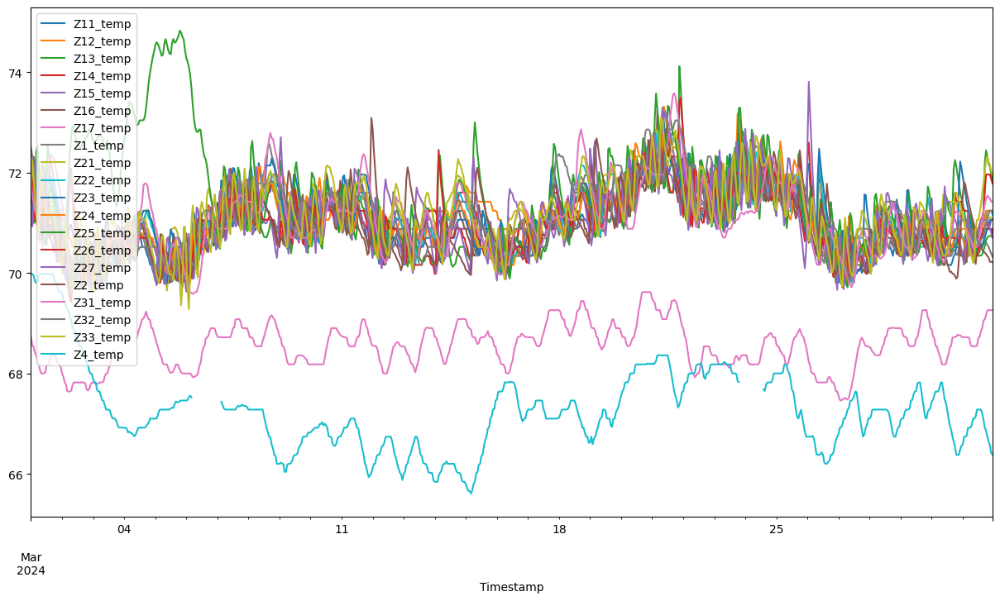

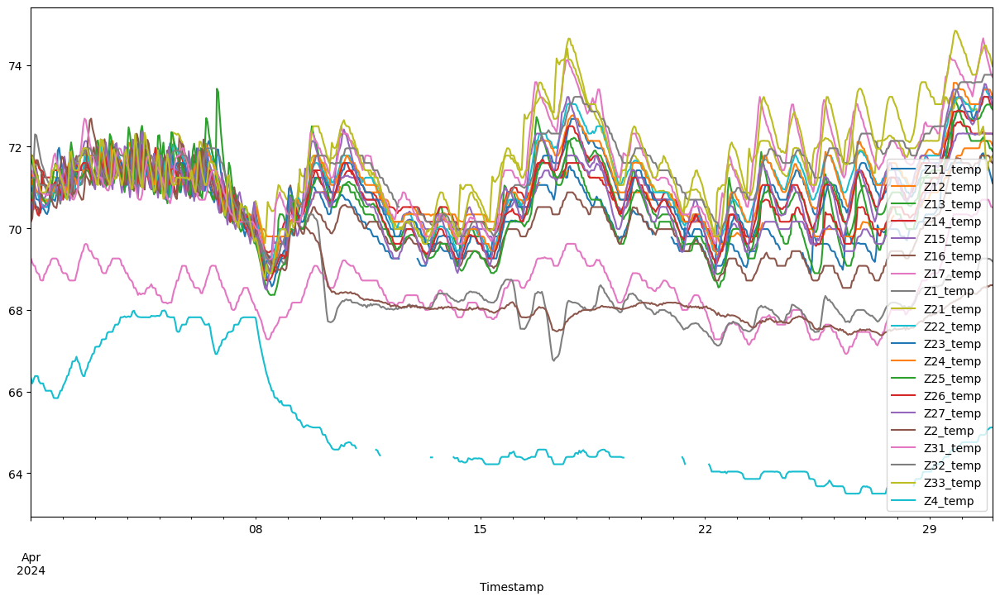

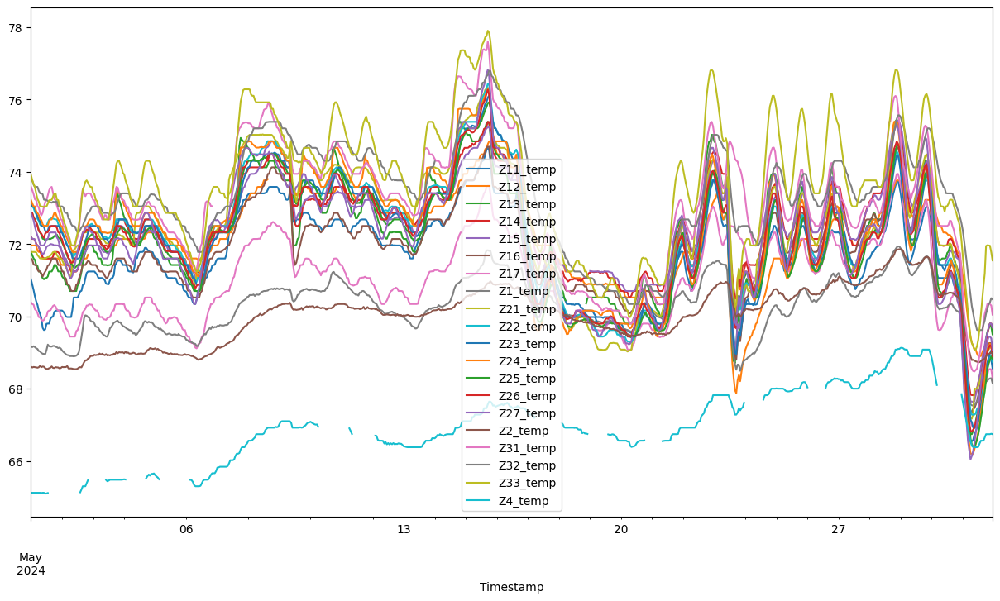

In [41]:
# Then, group by year and week number and apply Mahalanobis distance function
for (year, month), group in combined_df.groupby([combined_df.index.year, combined_df.index.month]):

    group.plot(figsize=(15, 8))

In [42]:
combined_df.isna().sum()

Z11_temp     162
Z12_temp     686
Z13_temp     331
Z14_temp     159
Z15_temp     106
Z16_temp     211
Z17_temp     176
Z1_temp       46
Z21_temp      46
Z22_temp      60
Z23_temp     110
Z24_temp     145
Z25_temp      46
Z26_temp      60
Z27_temp      46
Z2_temp       46
Z31_temp     102
Z32_temp     115
Z33_temp      61
Z4_temp     1288
dtype: int64

In [43]:
#Missing Data Check
def find_nan_sequences(series):
    is_nan = series.isna()
    if is_nan.any():
        start = end = None
        for i, val in enumerate(is_nan):
            if val and start is None:
                start = i
            elif not val and start is not None:
                end = i - 1
                yield (series.index[start], series.index[end])
                start = end = None
        if start is not None:
            yield (series.index[start], series.index[-1])

# Find and print start and end indices of NaN sequences in each column
empDF = pd.DataFrame()
LstN = []
LstS = []
LstE = []

for column in combined_df.columns:
    for start, end in find_nan_sequences(combined_df[column]):
        print(f"Missing period:'{column}' from {start} to {end}")
        LstN.append(column)
        LstS.append(start)
        LstE.append(end)
        
empDF["names"] = LstN
empDF["start"] = LstS
empDF["end"] = LstE

Missing period:'Z11_temp' from 2023-07-11 14:00:00-04:00 to 2023-07-12 06:00:00-04:00
Missing period:'Z11_temp' from 2023-07-23 13:00:00-04:00 to 2023-07-24 01:00:00-04:00
Missing period:'Z11_temp' from 2023-09-03 17:00:00-04:00 to 2023-09-04 05:00:00-04:00
Missing period:'Z11_temp' from 2023-09-05 14:00:00-04:00 to 2023-09-07 11:00:00-04:00
Missing period:'Z11_temp' from 2023-10-17 12:00:00-04:00 to 2023-10-18 03:00:00-04:00
Missing period:'Z11_temp' from 2023-10-24 14:00:00-04:00 to 2023-10-25 04:00:00-04:00
Missing period:'Z11_temp' from 2024-04-12 12:00:00-04:00 to 2024-04-13 00:00:00-04:00
Missing period:'Z11_temp' from 2024-04-20 10:00:00-04:00 to 2024-04-20 22:00:00-04:00
Missing period:'Z11_temp' from 2024-04-24 09:00:00-04:00 to 2024-04-25 00:00:00-04:00
Missing period:'Z12_temp' from 2023-06-27 11:00:00-04:00 to 2023-06-28 02:00:00-04:00
Missing period:'Z12_temp' from 2023-06-29 15:00:00-04:00 to 2023-06-30 05:00:00-04:00
Missing period:'Z12_temp' from 2023-07-01 15:00:00-04:

In [44]:
empDF.to_csv(r'C:\Users\Sang\OneDrive - Harvard University\CGBC\DataRelease\Final_Processing_Code_2024\Missing Intervals\Year4\Missing_periods_ST_Year4.csv', index=False)

In [45]:
combined_df.to_csv(r'C:\Users\Sang\OneDrive - Harvard University\CGBC\DataRelease\Final_Processing_Code_2024\Processed\Desigo\Year4\Zone_ST_Year4.csv', index=True)